In [1]:
import os 
import scanpy as sc 
import numpy as np
import functools
import yaml
from sklearn.metrics.cluster import adjusted_mutual_info_score, adjusted_rand_score, mutual_info_score, fowlkes_mallows_score, completeness_score, contingency_matrix, \
pair_confusion_matrix, homogeneity_completeness_v_measure, homogeneity_score, normalized_mutual_info_score, rand_score, silhouette_score, v_measure_score

import argparse
import functools
import pathlib
import scipy.stats as stats

import anndata
import numpy as np
import pandas as pd
from scipy.stats import ttest_ind

import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42

result_path = "/home/users/nus/changxu/scratch/DIRAC/Section-2/Results"
data_name_list = [f"sim_{i+1}" for i in range(10)]
methods_list = ["MultiVI", "RNA", "ADT", "ATAC", "SpatialGLUE", "SpatialGLUE_3M", "DIRAC", "DIRAC_3M"] 
data_path = "/home/project/11003054/changxu/Projects/DIRAC/Section-2/simulations/sp_multi_omics"

gt = "ground_truth"

results_list = []

for i in range(len(data_name_list)):
    for j in range(len(methods_list)):
        adata = sc.read(os.path.join(data_path, f"{data_name_list[i]}", "sim_RNA.h5ad"))
        if methods_list[j] == "SpatialGLUE_3M":
            df = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_SpatialGLUE", f"{data_name_list[i]}_{methods_list[j]}.csv"))
            methods = "SpatialGLUE"
            save_clustering_results = os.path.join(result_path, f"{data_name_list[i]}_SpatialGLUE", "clustering_3M.yaml")
        elif methods_list[j] == "DIRAC_3M":
            df = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_DIRAC", f"{data_name_list[i]}_{methods_list[j]}.csv"))
            methods = "DIRAC"
            save_clustering_results = os.path.join(result_path, f"{data_name_list[i]}_DIRAC", "clustering_3M.yaml")
        else:
            df = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_{methods_list[j]}", f"{data_name_list[i]}_{methods_list[j]}.csv"))
            methods = methods_list[j]
            save_clustering_results = os.path.join(result_path, f"{data_name_list[i]}_{methods_list[j]}", "clustering.yaml")
        if methods_list[j] == 'MultiVI':
            df.columns = ['Barcode', methods_list[j]]
            df['Barcode'] = df['Barcode'].str.split('_').str[0]
            df = df.set_index('Barcode').reindex(adata.obs_names).reset_index()
        elif methods_list[j] == 'Seurat':
            df.rename(columns={df.columns[-1]: f"{methods_list[j]}"}, inplace=True)
            

        # Convert NumPy objects to Python types
        metrics_clustering = {
            "Dataset": data_name_list[i],
            "Method": methods_list[j],
            "adjusted_mutual_info_score": float(adjusted_mutual_info_score(df[methods], adata.obs[gt])),
            "adjusted_rand_score": float(adjusted_rand_score(df[methods], adata.obs[gt])),
            "mutual_info_score": float(mutual_info_score(df[methods], adata.obs[gt])),
            "fowlkes_mallows_score": float(fowlkes_mallows_score(df[methods], adata.obs[gt])),
            "completeness_score": float(completeness_score(df[methods], adata.obs[gt])),
            "homogeneity_score": float(homogeneity_score(df[methods], adata.obs[gt])),
            "normalized_mutual_info_score": float(normalized_mutual_info_score(df[methods], adata.obs[gt])),
            "rand_score": float(rand_score(df[methods], adata.obs[gt])),
            "v_measure_score": float(v_measure_score(df[methods], adata.obs[gt])),
         }
        print(metrics_clustering)
        with open(save_clustering_results, "w", encoding="utf-8") as g:
            yaml.dump(metrics_clustering, g, default_flow_style=False, allow_unicode=True)

        results_list.append(metrics_clustering)
        
summary_df = pd.DataFrame(results_list)
summary_df.to_csv(os.path.join(result_path, "sim_metrics.csv"))

{'Dataset': 'sim_1', 'Method': 'MultiVI', 'adjusted_mutual_info_score': 0.0007645759053154313, 'adjusted_rand_score': 0.007304929362111137, 'mutual_info_score': 0.0028223247901585577, 'fowlkes_mallows_score': 0.4465600526395514, 'completeness_score': 0.002432167474816884, 'homogeneity_score': 0.0026393352085031427, 'normalized_mutual_info_score': 0.0025315200050561844, 'rand_score': 0.5090747577075702, 'v_measure_score': 0.002531520005056184}
{'Dataset': 'sim_1', 'Method': 'RNA', 'adjusted_mutual_info_score': 0.0006360749559634786, 'adjusted_rand_score': 0.008707140255403794, 'mutual_info_score': 0.0027668513570634386, 'fowlkes_mallows_score': 0.3714468504871836, 'completeness_score': 0.002384362672137601, 'homogeneity_score': 0.0020134383822269656, 'normalized_mutual_info_score': 0.0021832580700605403, 'rand_score': 0.5330094818376069, 'v_measure_score': 0.0021832580700605403}
{'Dataset': 'sim_1', 'Method': 'ADT', 'adjusted_mutual_info_score': 0.28205791098387695, 'adjusted_rand_score

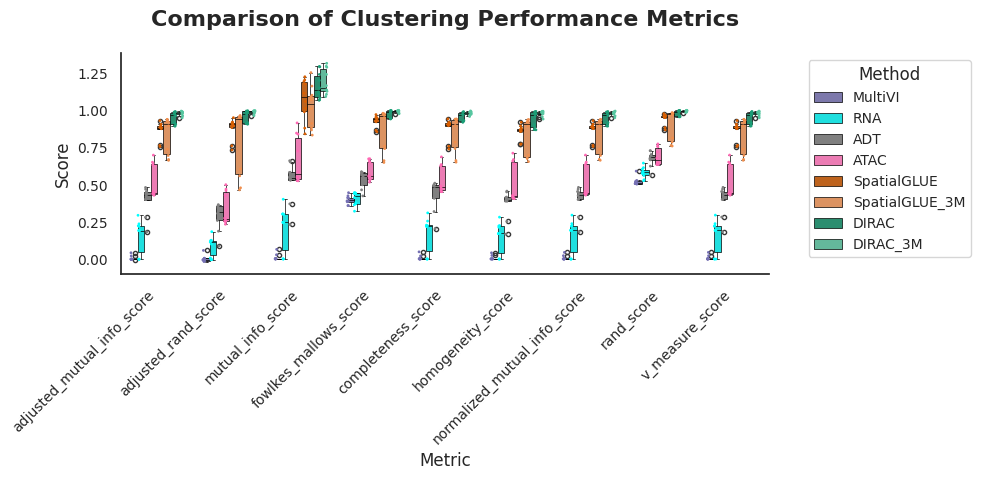

In [2]:
melted_df = summary_df.melt(id_vars=['Dataset', 'Method'], 
                           value_vars=['adjusted_mutual_info_score', 'adjusted_rand_score', 'mutual_info_score',
                                      'fowlkes_mallows_score', 'completeness_score', 'homogeneity_score',
                                      'normalized_mutual_info_score', 'rand_score', 'v_measure_score'],
                           var_name='Metric', 
                           value_name='Score')


sns.set(style="white", font_scale=1.1, rc={"axes.labelsize": 12, "xtick.labelsize": 10, "ytick.labelsize": 10})

methods_in_data = melted_df['Method'].unique()
palette_used = {k: v for k, v in {
    "ADT": "#808080",  
    "RNA": "#00FFFF",  
    "ATAC": "#ff69b4",  
    "MultiVI": "#7570b3",  
    "SpatialGLUE": "#d95f02",  
    "SpatialGLUE_3M": "#f08f4e",  
    "DIRAC": "#1b9e77",  
    "DIRAC_3M": "#56c6a0"
}.items() if k in methods_in_data}


plt.figure(figsize=(10, 5))

ax = sns.boxplot(
    data=melted_df,
    x='Metric',
    y='Score',
    hue='Method',
    palette=palette_used,
    width=0.7,
    linewidth=0.5,
    fliersize=3,
    boxprops=dict(edgecolor='black'),
    whiskerprops=dict(color='black'),
    capprops=dict(color='black'),
    medianprops=dict(color='black')
)

sns.stripplot(
    data=melted_df,
    x='Metric',
    y='Score',
    hue='Method',
    dodge=True,
    palette=palette_used,
    alpha=1,
    size=2,
    jitter=True,
    marker='o',
    linewidth=0,
    ax=ax
)


handles, labels = ax.get_legend_handles_labels()
n_methods = len(methods_in_data)
plt.legend(handles[:n_methods], labels[:n_methods], title='Method', title_fontsize=12, fontsize=10, bbox_to_anchor=(1.05, 1), loc='upper left')

plt.title('Comparison of Clustering Performance Metrics', fontsize=16, weight='bold', pad=20)
plt.xlabel('Metric', fontsize=12)
plt.ylabel('Score', fontsize=12)
plt.xticks(rotation=45, ha='right')
ax.set_ylim(bottom=-0.1)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)

plt.tight_layout()
plt.savefig(os.path.join(result_path, "sim_metrics.pdf"), dpi=300)
plt.show()

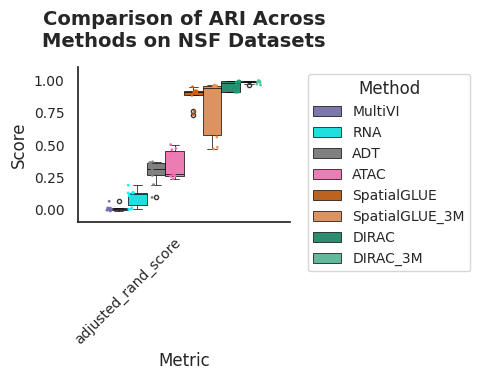

In [3]:
# Melting the dataframe
melted_df = summary_df.melt(id_vars=['Dataset', 'Method'], 
                            value_vars=['adjusted_rand_score'],
                            var_name='Metric', 
                            value_name='Score')

# Set style and font scale for seaborn plots
sns.set(style="white", font_scale=1.1, rc={"axes.labelsize": 12, "xtick.labelsize": 10, "ytick.labelsize": 10})

methods_in_data = melted_df['Method'].unique()
palette_used = {
    "ADT": "#808080",  
    "RNA": "#00FFFF",  
    "ATAC": "#ff69b4",  
    "MultiVI": "#7570b3",  
    "SpatialGLUE": "#d95f02",  
    "SpatialGLUE_3M": "#f08f4e",  
    "DIRAC": "#1b9e77",  
    "DIRAC_3M": "#56c6a0"
}

# Filter palette for methods present in the data
palette_used = {k: v for k, v in palette_used.items() if k in methods_in_data}

# Create the boxplot
plt.figure(figsize=(5, 4))

ax = sns.boxplot(
    data=melted_df,
    x='Metric',
    y='Score',
    hue='Method',
    palette=palette_used,
    width=0.7,
    linewidth=0.5,
    fliersize=3,
    boxprops=dict(edgecolor='black'),
    whiskerprops=dict(color='black'),
    capprops=dict(color='black'),
    medianprops=dict(color='black')
)

# Adding stripplot for individual points
sns.stripplot(
    data=melted_df,
    x='Metric',
    y='Score',
    hue='Method',
    dodge=True,
    palette=palette_used,
    alpha=1,
    size=2,
    jitter=True,
    marker='o',
    linewidth=0,
    ax=ax
)

# Legend customization
handles, labels = ax.get_legend_handles_labels()
plt.legend(handles[:len(methods_in_data)], labels[:len(methods_in_data)],
           title='Method', title_fontsize=12, fontsize=10, bbox_to_anchor=(1.05, 1), loc='upper left')

# Title and labels
plt.title('Comparison of ARI Across\nMethods on NSF Datasets', fontsize=14, weight='bold', pad=15)
plt.xlabel('Metric', fontsize=12)
plt.ylabel('Score', fontsize=12)
plt.xticks(rotation=45, ha='right')
ax.set_ylim(bottom=-0.1, top=1.1)

# Removing top and right spines for cleaner plot
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)

# Adjust layout to avoid overlap
plt.tight_layout()

# Save the plot
plt.savefig(os.path.join(result_path, "sim_metrics_ARI_with_pvals.pdf"), dpi=300)

# Show the plot
plt.show()



Method statistics (mean and variance):
           Method  adjusted_mutual_info_score_mean  \
0             ADT                         0.398880   
1            ATAC                         0.526301   
2           DIRAC                         0.947988   
3        DIRAC_3M                         0.977949   
4         MultiVI                         0.006920   
5             RNA                         0.155678   
6     SpatialGLUE                         0.865910   
7  SpatialGLUE_3M                         0.830972   

   adjusted_mutual_info_score_var  adjusted_rand_score_mean  \
0                        0.008866                  0.288002   
1                        0.012766                  0.339742   
2                        0.001708                  0.955852   
3                        0.000194                  0.986047   
4                        0.000219                  0.002828   
5                        0.012404                  0.090486   
6                        0.00340

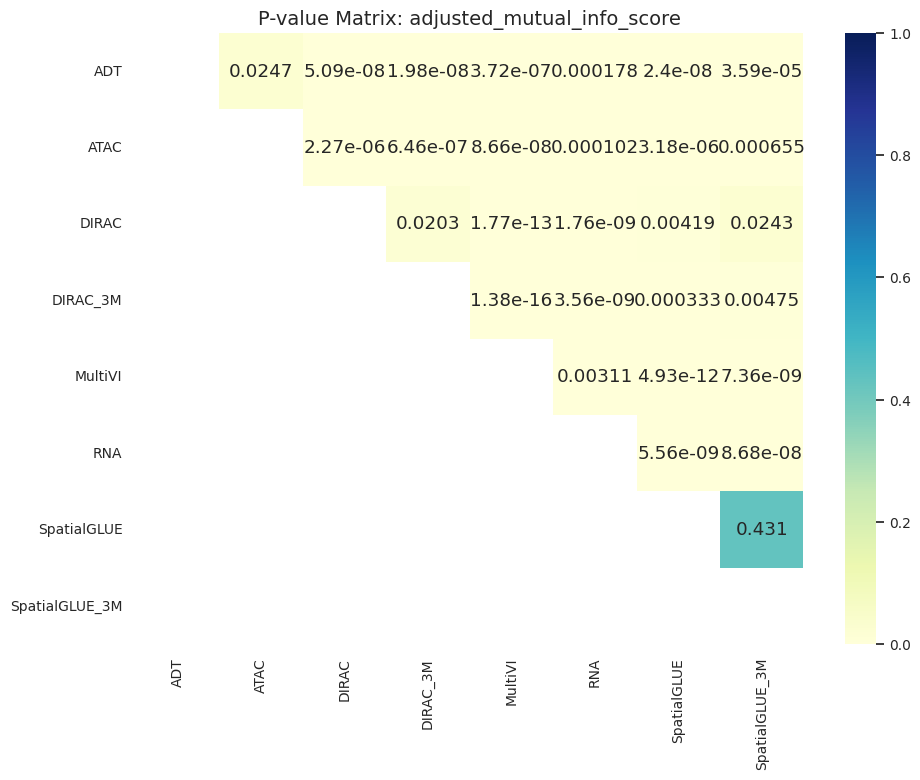

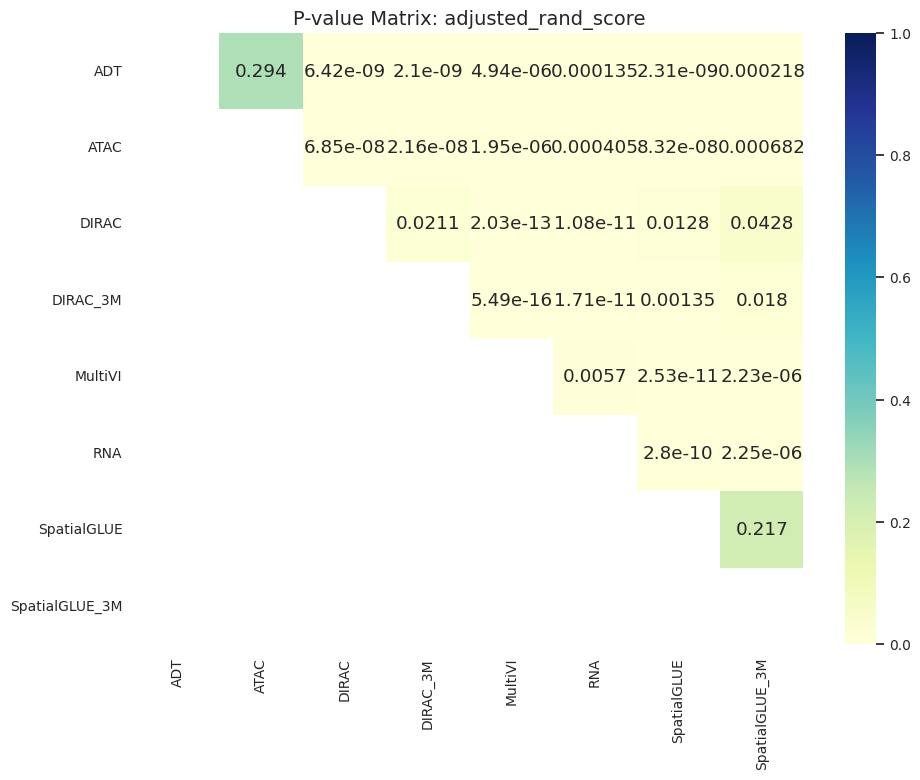

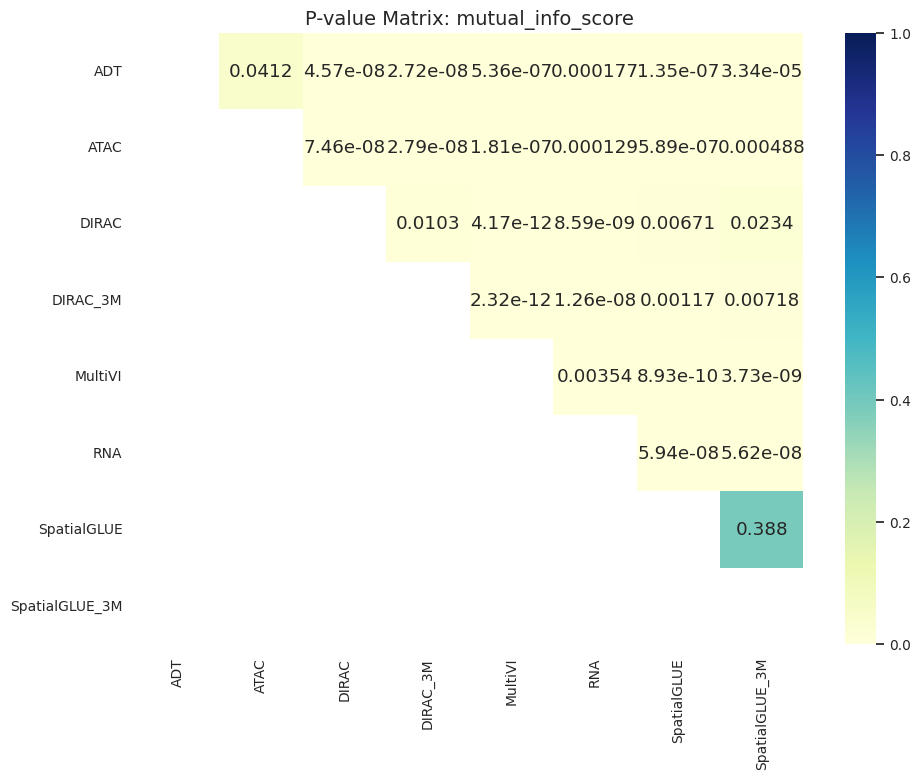

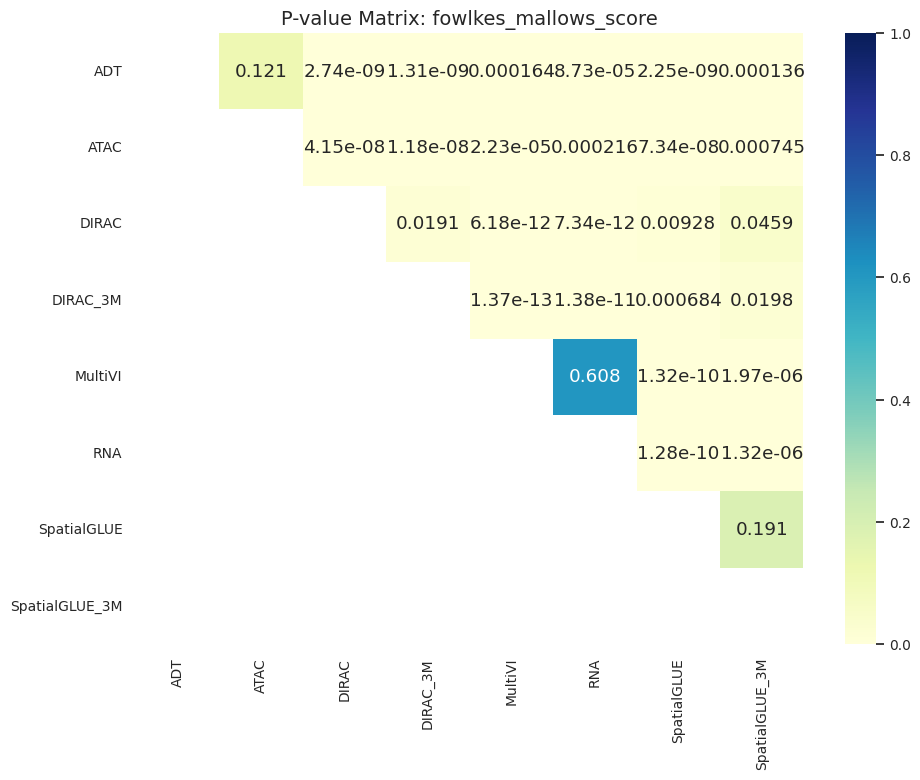

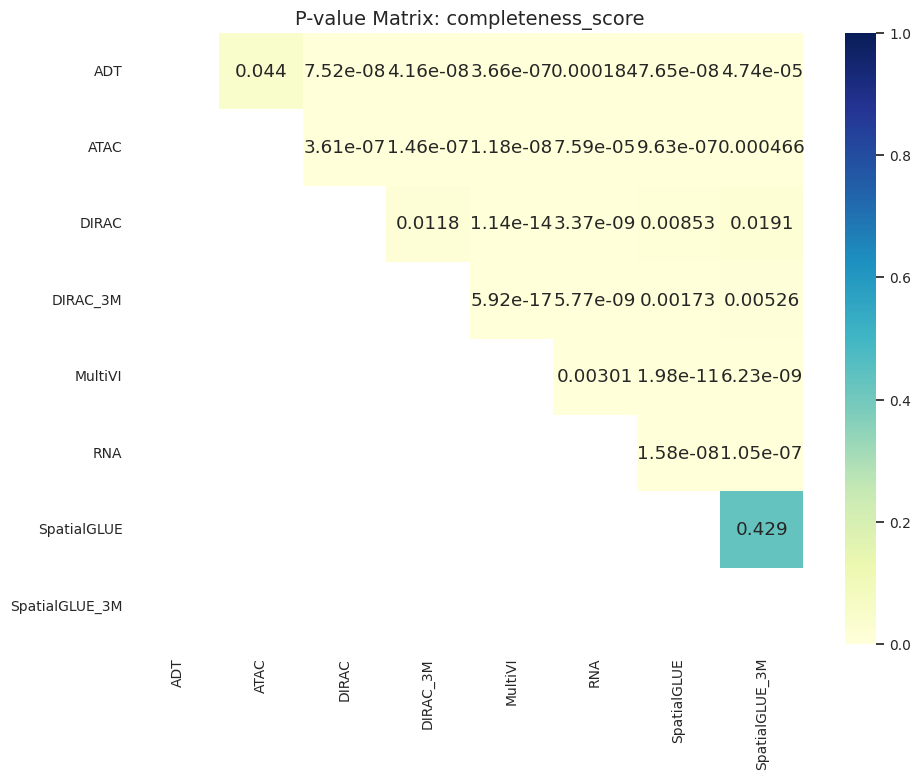

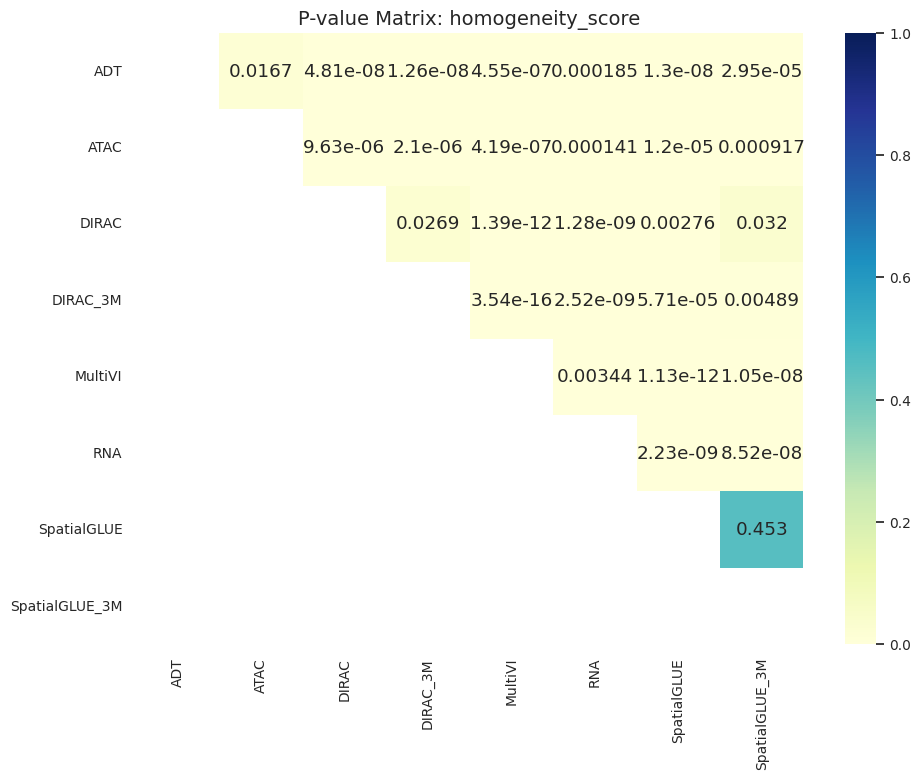

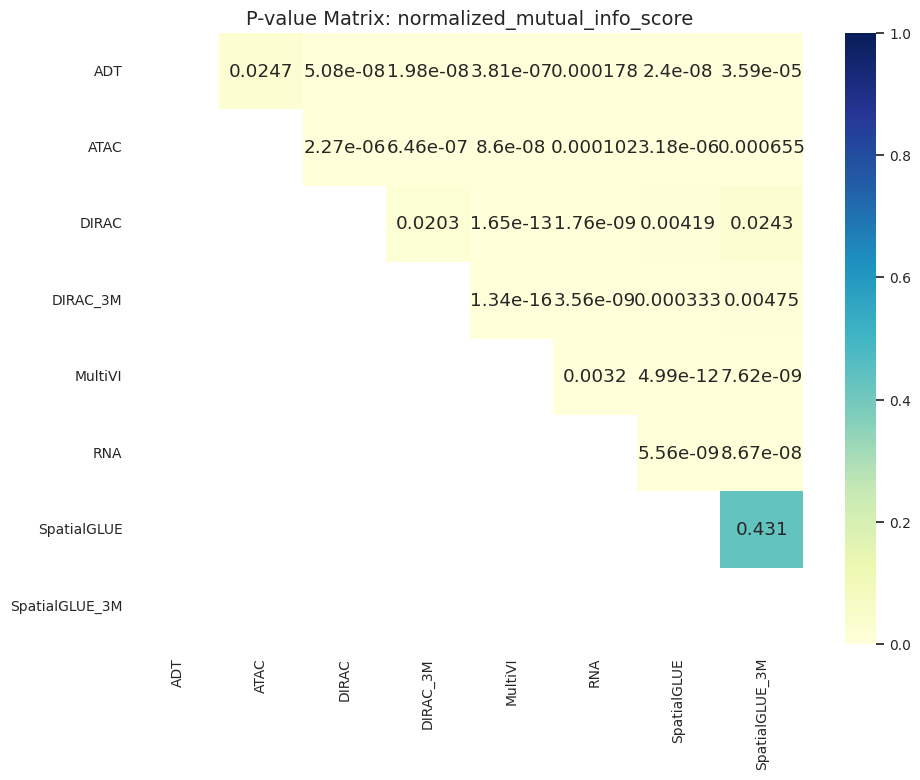

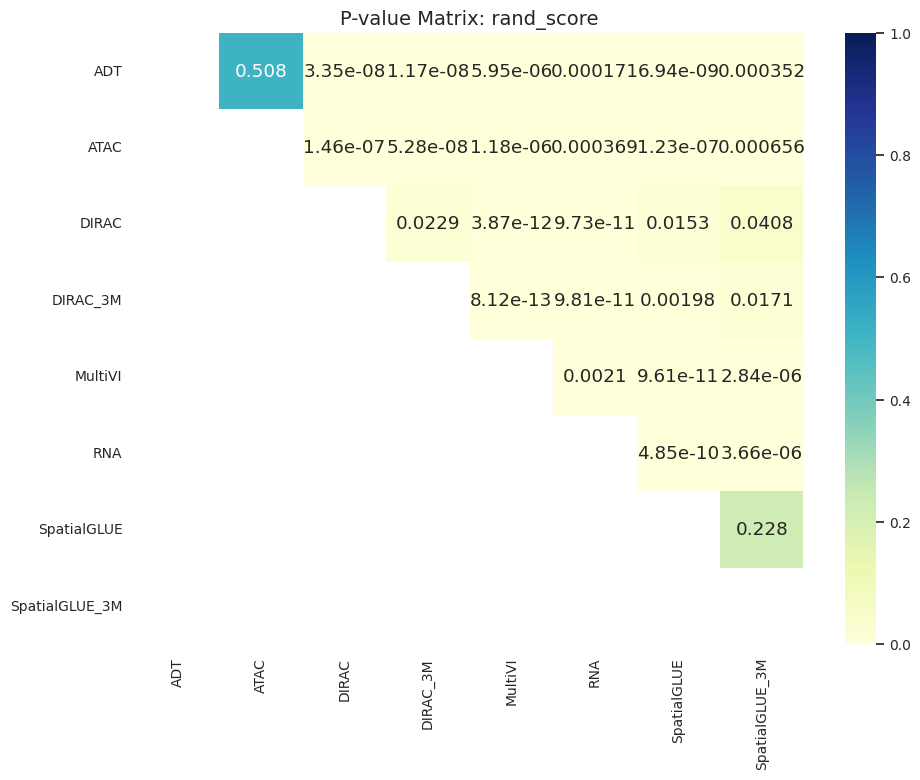

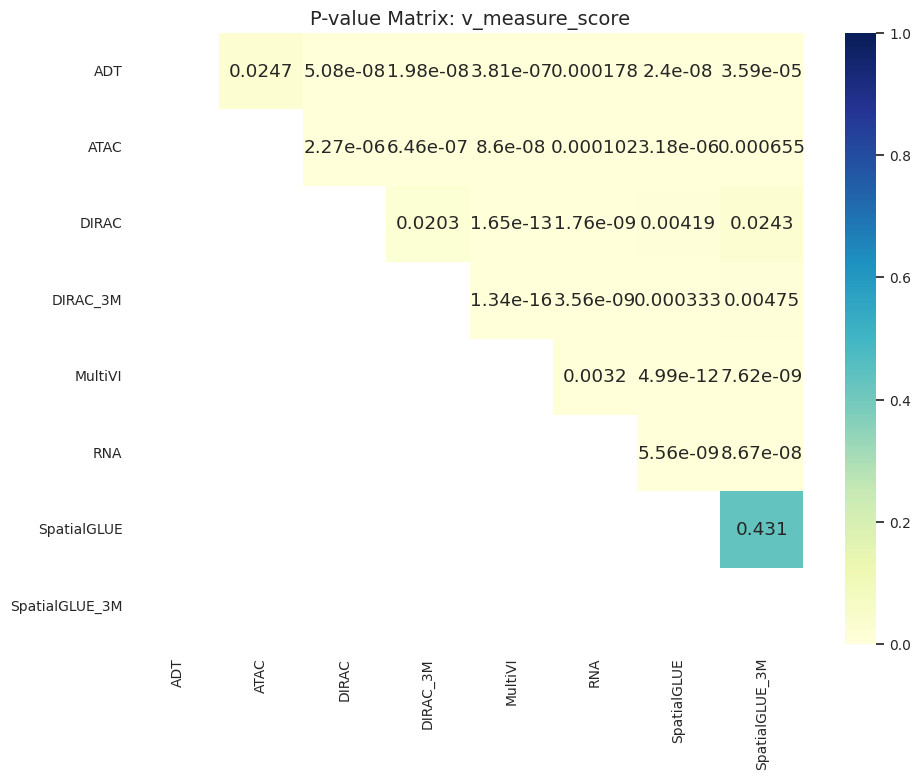

In [4]:
from itertools import combinations
from scipy.stats import ttest_rel

# Step 1: Calculate mean and variance for each method across numeric columns
numeric_cols = summary_df.select_dtypes(include=['number']).columns.tolist()

# Group by 'Method' and compute mean and variance
method_stats = summary_df.groupby('Method')[numeric_cols].agg(['mean', 'var'])

# Flatten multi-level column names
method_stats.columns = ['_'.join(col).strip() for col in method_stats.columns.values]
method_stats = method_stats.reset_index()

# Save method statistics to CSV
method_stats.to_csv(os.path.join(result_path, "sim_method_stats.csv"), index=False)

print("\nMethod statistics (mean and variance):")
print(method_stats)

# Step 2: Function to calculate all pairwise t-test p-values between methods (with means/variances)
def calculate_all_pairwise_p_values(df, metrics):
    p_values = []

    # Precompute mean and variance for each method and metric
    stats_df = df.groupby('Method')[metrics].agg(['mean', 'var'])

    for metric in metrics:
        # Create a pivot table: rows = datasets, columns = methods, values = metric scores
        metric_df = df[['Dataset', 'Method', metric]].copy()
        pivot_df = metric_df.pivot(index='Dataset', columns='Method', values=metric)

        methods = pivot_df.columns.tolist()

        # Compare every pair of methods
        for method_a, method_b in combinations(methods, 2):
            try:
                # Remove rows with missing values for this method pair
                paired_data = pivot_df[[method_a, method_b]].dropna()
                if len(paired_data) > 1:
                    t_stat, p_val = ttest_rel(
                        paired_data[method_a],
                        paired_data[method_b],
                        alternative='two-sided'
                    )

                    # Get stats for Method_A
                    mean_a = stats_df.loc[method_a, (metric, 'mean')]
                    var_a = stats_df.loc[method_a, (metric, 'var')]

                    # Get stats for Method_B
                    mean_b = stats_df.loc[method_b, (metric, 'mean')]
                    var_b = stats_df.loc[method_b, (metric, 'var')]

                    p_values.append({
                        'Metric': metric,
                        'Comparison': f"{method_a} vs {method_b}",
                        'Method_A': method_a,
                        'Mean_A': mean_a,
                        'Var_A': var_a,
                        'Method_B': method_b,
                        'Mean_B': mean_b,
                        'Var_B': var_b,
                        'p_value': p_val
                    })
            except Exception as e:
                print(f"Error comparing {method_a} vs {method_b} for {metric}: {str(e)}")

    return pd.DataFrame(p_values)

# Step 3: List of metrics to evaluate
metrics = [
    'adjusted_mutual_info_score', 'adjusted_rand_score', 'mutual_info_score',
    'fowlkes_mallows_score', 'completeness_score', 'homogeneity_score',
    'normalized_mutual_info_score', 'rand_score', 'v_measure_score'
]

# Step 4: Run the pairwise p-value calculation
p_value_df = calculate_all_pairwise_p_values(summary_df, metrics)
p_value_df.to_csv(os.path.join(result_path, "sim_p_values_all_pairs.csv"), index=False)

print("\nAll pairwise p-values between methods (with mean and variance):")
print(p_value_df)

# Step 5: Create heatmaps for each metric's p-value matrix
for metric in metrics:
    subset = p_value_df[p_value_df['Metric'] == metric]
    if not subset.empty:
        # Create square matrix (methods x methods) with p-values
        methods = sorted(set(subset['Method_A']).union(set(subset['Method_B'])))
        heatmap_matrix = pd.DataFrame(index=methods, columns=methods, dtype=float)

        # Fill upper triangle
        for _, row in subset.iterrows():
            heatmap_matrix.loc[row['Method_A'], row['Method_B']] = row['p_value']

        # Plot heatmap
        plt.figure(figsize=(10, 8))
        sns.heatmap(heatmap_matrix, annot=True, fmt=".3g", cmap="YlGnBu", vmin=0, vmax=1)
        plt.title(f"P-value Matrix: {metric}", fontsize=14)
        plt.tight_layout()
        plt.savefig(os.path.join(result_path, f"sim_p_values_matrix_{metric}.pdf"), dpi=300)
        plt.show()

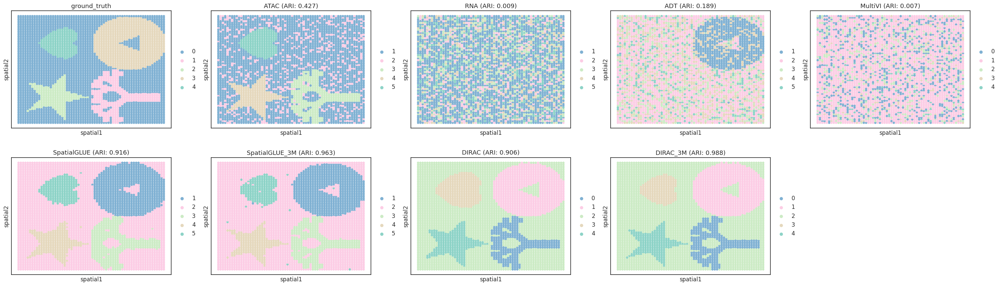

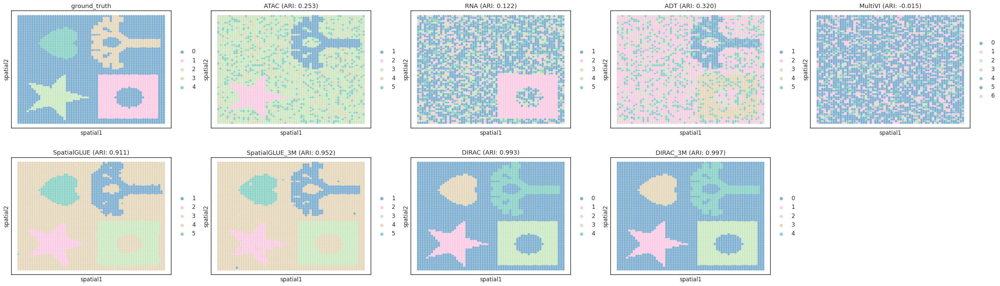

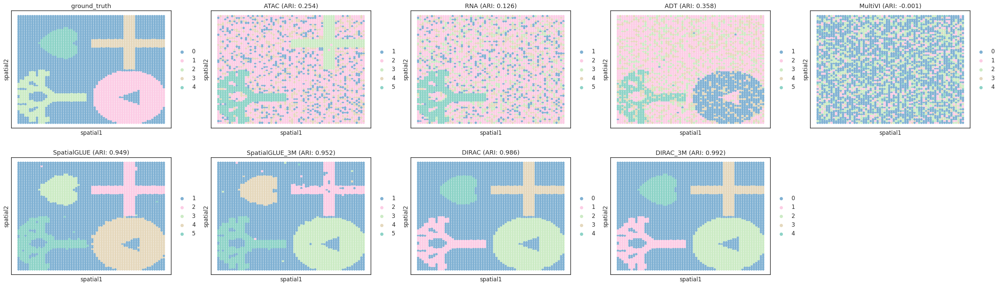

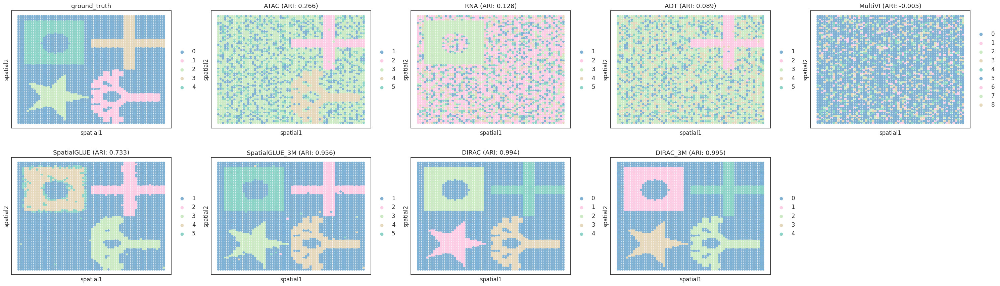

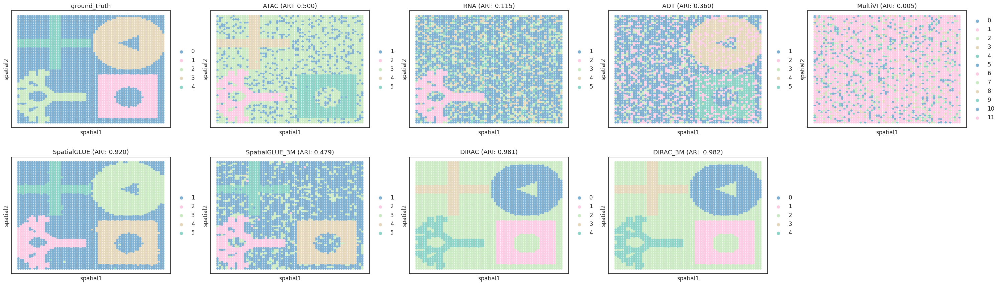

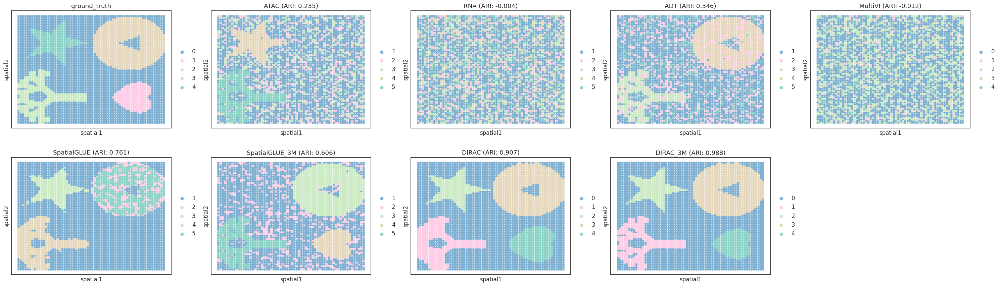

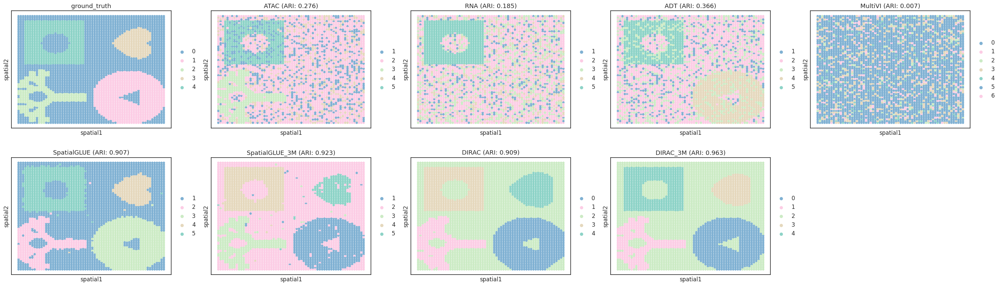

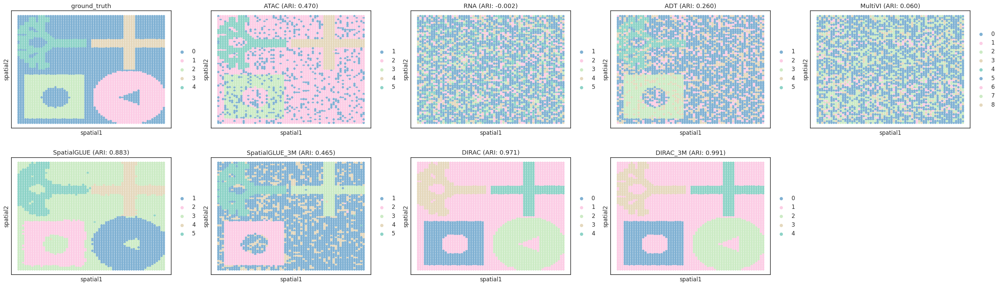

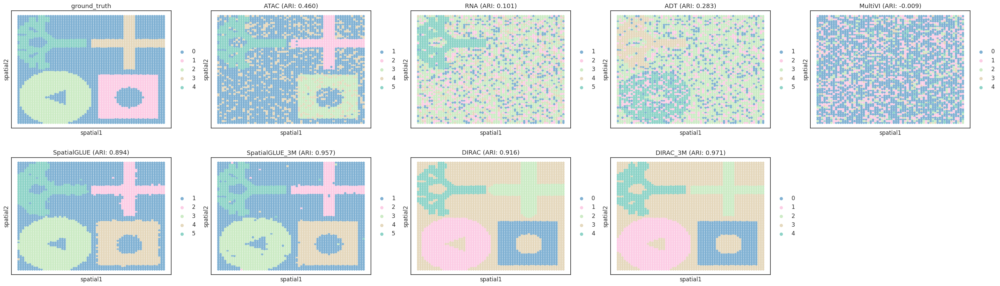

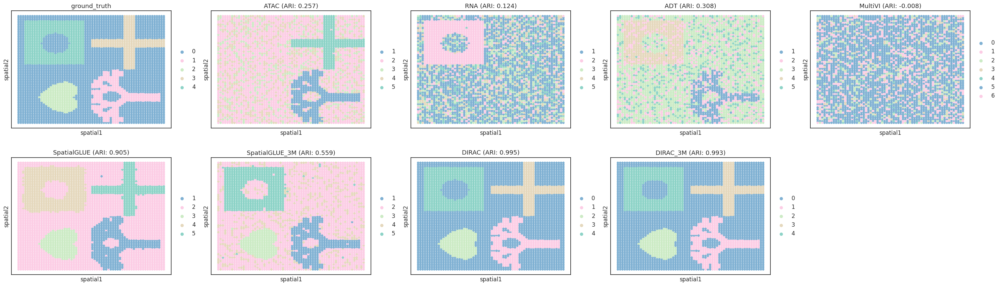

In [5]:
import os
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics.cluster import adjusted_rand_score
import matplotlib as mpl

mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42

use_obs = "ground_truth"
result_path = "/home/users/nus/changxu/scratch/DIRAC/Section-2/Results"
data_name_list = [f"sim_{i+1}" for i in range(10)]
methods_list = ["ATAC", "RNA", "ADT", "MultiVI", "SpatialGLUE", "SpatialGLUE_3M", "DIRAC", "DIRAC_3M"]
data_path = "/home/project/11003054/changxu/Projects/DIRAC/Section-2/simulations/sp_multi_omics_final"

color_maps = ["#80B1D3", "#FCCDE5", "#CCEBC5", "#E5D8BD", "#8DD3C7"]
# color_maps= ["#A65628", "#FFFF33", "#F781BF", "#999999",
#             "#E5D8BD", "#B3CDE3", "#CCEBC5", "#FED9A6", "#FBB4AE", "#8DD3C7", "#BEBADA", "#80B1D3", "#B3DE69", "#FCCDE5",
#             "#BC80BD", "#FFED6F", "#8DA0CB", "#E78AC3", "#E5C494", "#CCCCCC", "#FB9A99", "#E31A1C", "#CAB2D6","#6A3D9A", 
#             "#B15928"]

for i in range(10):
    adata = sc.read(os.path.join(data_path, data_name_list[i], "sim_RNA.h5ad"))
    
    all_list = [use_obs] + methods_list  
    titles = [use_obs]  

    for j in methods_list:
        if j == "DIRAC_3M":
            df = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_DIRAC", f"{data_name_list[i]}_{j}.csv"))
        elif j == "SpatialGLUE_3M":
            df = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_SpatialGLUE", f"{data_name_list[i]}_{j}.csv"))
        else:
            df = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_{j}", f"{data_name_list[i]}_{j}.csv"))

        if j == 'MultiVI':
            df.columns = ['Barcode', j]
            df['Barcode'] = df['Barcode'].str.split('_').str[0]
            df = df.set_index('Barcode').reindex(adata.obs_names).reset_index()
        if j == "DIRAC_3M":
            adata.obs[j] = df["DIRAC"].tolist()
        elif j == "SpatialGLUE_3M":
            adata.obs[j] = df["SpatialGLUE"].tolist()
        else:
            adata.obs[j] = df[j].tolist()

        adata.obs[j] = adata.obs[j].astype('category')
        ARI = float(adjusted_rand_score(adata.obs[j], adata.obs[use_obs]))
        titles.append(f"{j} (ARI: {ARI:.3f})")

    sc.pl.embedding(
        adata,
        basis='spatial',
        color=all_list,
        title=titles,
        s=100,
        show=False,
        ncols=5,
        palette=color_maps
    )
    plt.savefig(os.path.join("/home/users/nus/changxu/scratch/DIRAC/Section-2/PDF", f"{data_name_list[i]}_NSF.pdf"), dpi=300)
    plt.show()

{'Dataset': 'sim_1', 'Method': 'ATAC', 'adjusted_mutual_info_score': 0.7143361368820937, 'adjusted_rand_score': 0.4986784582322891, 'mutual_info_score': 1.432070734266746, 'fowlkes_mallows_score': 0.612982667384053, 'completeness_score': 0.6824761386553619, 'homogeneity_score': 0.7790976542398037, 'normalized_mutual_info_score': 0.727593175638132, 'rand_score': 0.8369298597194389, 'v_measure_score': 0.727593175638132}
{'Dataset': 'sim_1', 'Method': 'SpatialGLUE', 'adjusted_mutual_info_score': 0.5346062638257904, 'adjusted_rand_score': 0.30442356287975675, 'mutual_info_score': 1.1320531182741205, 'fowlkes_mallows_score': 0.42082921539523216, 'completeness_score': 0.539497960837858, 'homogeneity_score': 0.571923863631496, 'normalized_mutual_info_score': 0.5552378968822548, 'rand_score': 0.8071342685370742, 'v_measure_score': 0.5552378968822547}
{'Dataset': 'sim_1', 'Method': 'MultiVI', 'adjusted_mutual_info_score': 0.6186444021328331, 'adjusted_rand_score': 0.3826093823794713, 'mutual_in

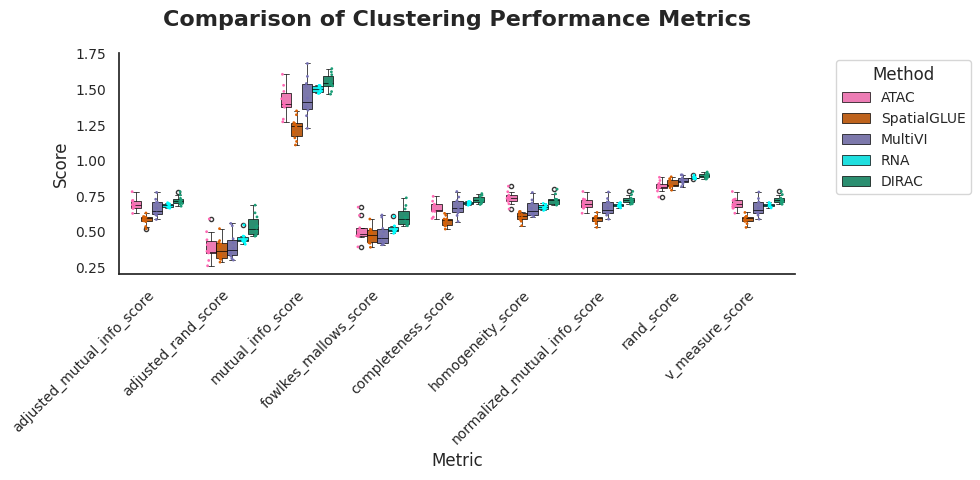

In [5]:
import os 
import scanpy as sc 
import numpy as np
import functools
import yaml
from sklearn.metrics.cluster import adjusted_mutual_info_score, adjusted_rand_score, mutual_info_score, fowlkes_mallows_score, completeness_score, contingency_matrix, \
pair_confusion_matrix, homogeneity_completeness_v_measure, homogeneity_score, normalized_mutual_info_score, rand_score, silhouette_score, v_measure_score

import argparse
import functools
import pathlib
import os

import anndata
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42

result_path = "/home/users/nus/changxu/scratch/DIRAC/Section-2/Results"
data_name_list = [f"sim_{i+1}" for i in range(10)]
methods_list = ["ATAC","SpatialGLUE", "MultiVI",  "RNA", "DIRAC"] #  
data_path = "/home/project/11003054/changxu/Projects/DIRAC/Section-2/scMultiSim_data"

gt = "cell.type"

results_list = []

for i in range(len(data_name_list)):
    for j in range(len(methods_list)):
        adata = sc.read(os.path.join(data_path, f"{data_name_list[i]}", "sim_RNA.h5ad"))
        df = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_scMultiSim_{methods_list[j]}", f"{data_name_list[i]}_{methods_list[j]}.csv"))
        methods = methods_list[j]
        save_clustering_results = os.path.join(result_path, f"{data_name_list[i]}_scMultiSim_{methods_list[j]}", "clustering.yaml")
        if methods_list[j] == 'MultiVI':
            df.columns = ['Barcode', methods_list[j]]
            df['Barcode'] = df['Barcode'].str.split('_').str[0]
            df = df.set_index('Barcode').reindex(adata.obs_names).reset_index()
            
        # Convert NumPy objects to Python types
        metrics_clustering = {
            "Dataset": data_name_list[i],
            "Method": methods_list[j],
            "adjusted_mutual_info_score": float(adjusted_mutual_info_score(df[methods], adata.obs[gt])),
            "adjusted_rand_score": float(adjusted_rand_score(df[methods], adata.obs[gt])),
            "mutual_info_score": float(mutual_info_score(df[methods], adata.obs[gt])),
            "fowlkes_mallows_score": float(fowlkes_mallows_score(df[methods], adata.obs[gt])),
            "completeness_score": float(completeness_score(df[methods], adata.obs[gt])),
            "homogeneity_score": float(homogeneity_score(df[methods], adata.obs[gt])),
            "normalized_mutual_info_score": float(normalized_mutual_info_score(df[methods], adata.obs[gt])),
            "rand_score": float(rand_score(df[methods], adata.obs[gt])),
            "v_measure_score": float(v_measure_score(df[methods], adata.obs[gt])),
         }
        print(metrics_clustering)
        with open(save_clustering_results, "w", encoding="utf-8") as g:
            yaml.dump(metrics_clustering, g, default_flow_style=False, allow_unicode=True)

        results_list.append(metrics_clustering)
        
summary_df = pd.DataFrame(results_list)
summary_df.to_csv(os.path.join(result_path, "sim_scMultiSim_metrics.csv"))


melted_df = summary_df.melt(id_vars=['Dataset', 'Method'], 
                           value_vars=['adjusted_mutual_info_score', 'adjusted_rand_score', 'mutual_info_score',
                                      'fowlkes_mallows_score', 'completeness_score', 'homogeneity_score',
                                      'normalized_mutual_info_score', 'rand_score', 'v_measure_score'],
                           var_name='Metric', 
                           value_name='Score')

sns.set(style="white", font_scale=1.1, rc={"axes.labelsize": 12, "xtick.labelsize": 10, "ytick.labelsize": 10})

methods_in_data = melted_df['Method'].unique()
palette_used = {k: v for k, v in {
    "ATAC": "#ff69b4", 
    "RNA": "#00FFFF",  
    "MultiVI": "#7570b3",  
    "SpatialGLUE": "#d95f02",  
    "DIRAC": "#1b9e77",  
}.items() if k in methods_in_data}

plt.figure(figsize=(10, 5))

ax = sns.boxplot(
    data=melted_df,
    x='Metric',
    y='Score',
    hue='Method',
    palette=palette_used,
    width=0.7,
    linewidth=0.5,
    fliersize=3,
    boxprops=dict(edgecolor='black'),
    whiskerprops=dict(color='black'),
    capprops=dict(color='black'),
    medianprops=dict(color='black')
)

sns.stripplot(
    data=melted_df,
    x='Metric',
    y='Score',
    hue='Method',
    dodge=True,
    palette=palette_used,
    alpha=1,
    size=2,
    jitter=True,
    marker='o',
    linewidth=0,
    ax=ax
)


handles, labels = ax.get_legend_handles_labels()
n_methods = len(methods_in_data)
plt.legend(handles[:n_methods], labels[:n_methods], title='Method', title_fontsize=12, fontsize=10, bbox_to_anchor=(1.05, 1), loc='upper left')

plt.title('Comparison of Clustering Performance Metrics', fontsize=16, weight='bold', pad=20)
plt.xlabel('Metric', fontsize=12)
plt.ylabel('Score', fontsize=12)
plt.xticks(rotation=45, ha='right')
ax.set_ylim(bottom=0.2)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)

plt.tight_layout()
plt.savefig(os.path.join(result_path, "sim_scMultiSim_metrics.pdf"), dpi=300)
plt.show()

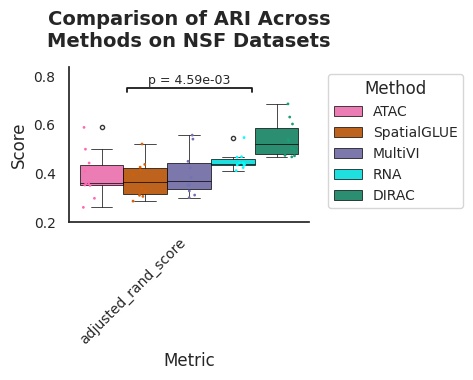

In [6]:
melted_df = summary_df.melt(id_vars=['Dataset', 'Method'], 
                           value_vars=['adjusted_rand_score'],
                           var_name='Metric', 
                           value_name='Score')


mean_scores = melted_df.groupby('Method')['Score'].mean().sort_values(ascending=False)
top_methods = mean_scores.index[:2].tolist()

group1 = melted_df[melted_df['Method'] == top_methods[0]]['Score']
group2 = melted_df[melted_df['Method'] == top_methods[1]]['Score']
tstat, pval = ttest_ind(group1, group2, equal_var=False)


sns.set(style="white", font_scale=1.1, rc={"axes.labelsize": 12, "xtick.labelsize": 10, "ytick.labelsize": 10})

methods_in_data = melted_df['Method'].unique()
palette_used = {k: v for k, v in {
    "ADT": "#808080",  
    "RNA": "#00FFFF",  
    "ATAC": "#ff69b4",  
    "MultiVI": "#7570b3",  
    "SpatialGLUE": "#d95f02",  
    "SpatialGLUE_3M": "#f08f4e",  
    "DIRAC": "#1b9e77",  
    "DIRAC_3M": "#56c6a0"
}.items() if k in methods_in_data}

plt.figure(figsize=(5, 4))

# Boxplot
ax = sns.boxplot(
    data=melted_df,
    x='Metric',
    y='Score',
    hue='Method',
    palette=palette_used,
    width=0.7,
    linewidth=0.5,
    fliersize=3,
    boxprops=dict(edgecolor='black'),
    whiskerprops=dict(color='black'),
    capprops=dict(color='black'),
    medianprops=dict(color='black')
)

# Stripplot
sns.stripplot(
    data=melted_df,
    x='Metric',
    y='Score',
    hue='Method',
    dodge=True,
    palette=palette_used,
    alpha=1,
    size=2,
    jitter=True,
    marker='o',
    linewidth=0,
    ax=ax
)

handles, labels = ax.get_legend_handles_labels()
unique = dict(zip(labels, handles))
plt.legend(unique.values(), unique.keys(),
           title='Method', title_fontsize=12, fontsize=10, bbox_to_anchor=(1.05, 1), loc='upper left')


def method_x_position(method, hue_order):
    idx = hue_order.index(method)
    total = len(hue_order)
    return -0.2 + idx * 0.4 / (total - 1)

hue_order = list(palette_used.keys())
x1 = method_x_position(top_methods[0], hue_order)
x2 = method_x_position(top_methods[1], hue_order)

y_max = melted_df['Score'].max()
y_start = y_max + 0.05
line_height = 0.015

ax.plot([x1, x1, x2, x2], [y_start, y_start + line_height, y_start + line_height, y_start], lw=1.3, c='k')
ax.text((x1 + x2) / 2, y_start + line_height + 0.005, f"p = {pval:.2e}", ha='center', va='bottom', fontsize=9)
plt.legend(handles[:n_methods], labels[:n_methods], title='Method', title_fontsize=12, fontsize=10, bbox_to_anchor=(1.05, 1), loc='upper left')

plt.title('Comparison of ARI Across\nMethods on NSF Datasets', fontsize=14, weight='bold', pad=15)
plt.xlabel('Metric', fontsize=12)
plt.ylabel('Score', fontsize=12)
plt.xticks(rotation=45, ha='right')
ax.set_ylim(bottom=0.2, top=y_start + 0.1)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)

plt.tight_layout()
plt.savefig(os.path.join(result_path, "scMultiSim_metrics_ARI_top2_pval.pdf"), dpi=300)
plt.show()


Method statistics (mean and variance):
        Method  adjusted_mutual_info_score_mean  \
0         ATAC                         0.692646   
1        DIRAC                         0.719918   
2      MultiVI                         0.664387   
3          RNA                         0.682167   
4  SpatialGLUE                         0.582249   

   adjusted_mutual_info_score_var  adjusted_rand_score_mean  \
0                        0.001754                  0.391030   
1                        0.000931                  0.540409   
2                        0.003641                  0.398873   
3                        0.000184                  0.449946   
4                        0.001145                  0.374600   

   adjusted_rand_score_var  mutual_info_score_mean  mutual_info_score_var  \
0                 0.009446                1.415284               0.010389   
1                 0.005635                1.550637               0.003286   
2                 0.008402                1

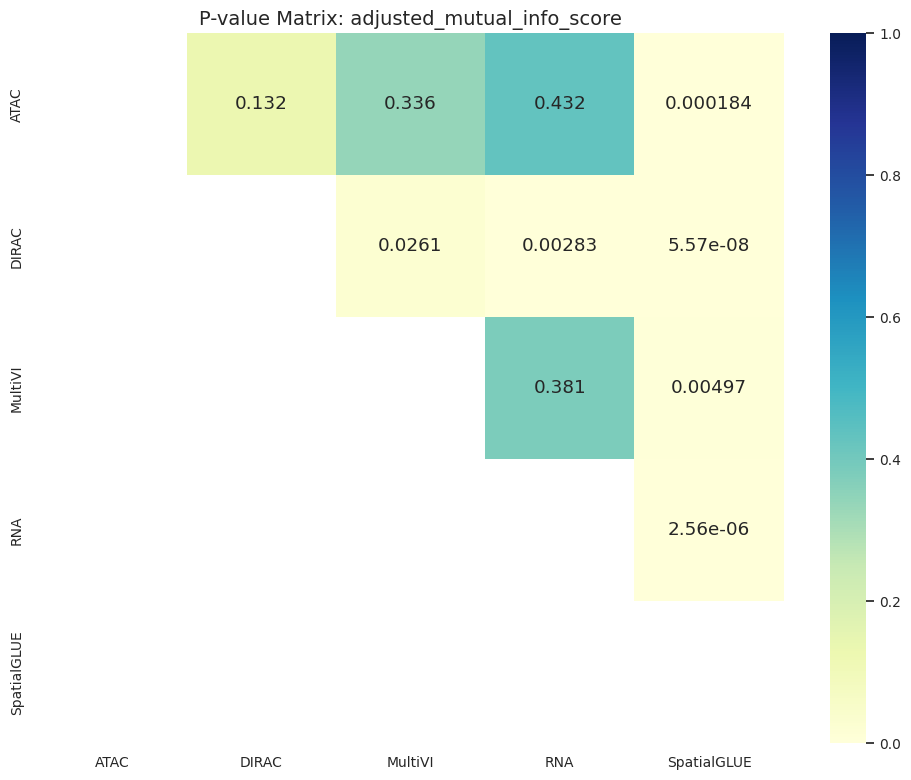

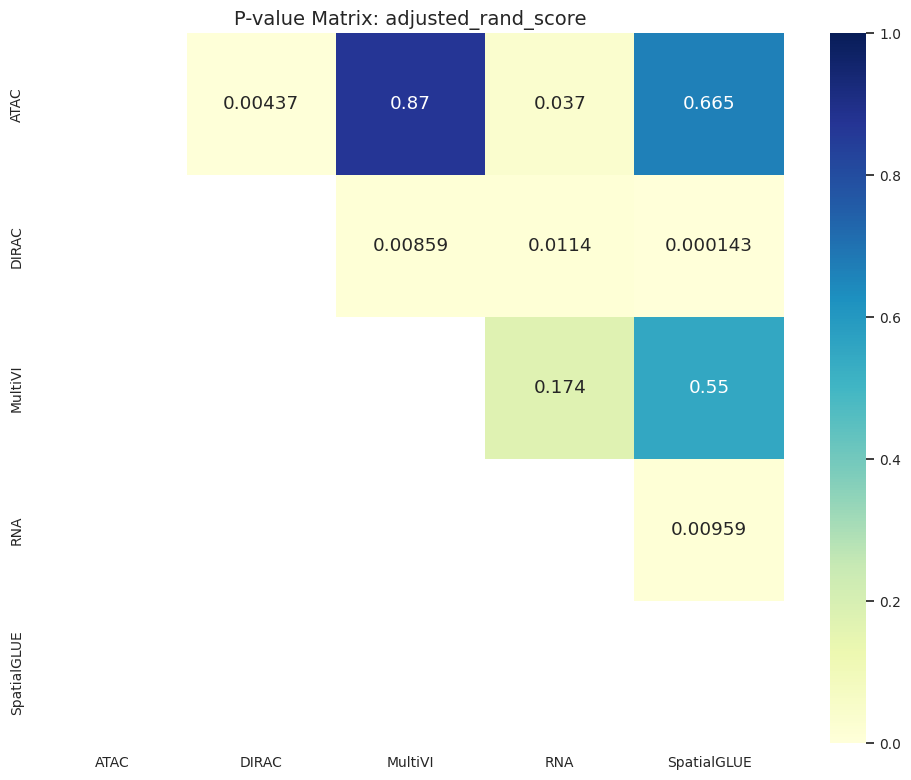

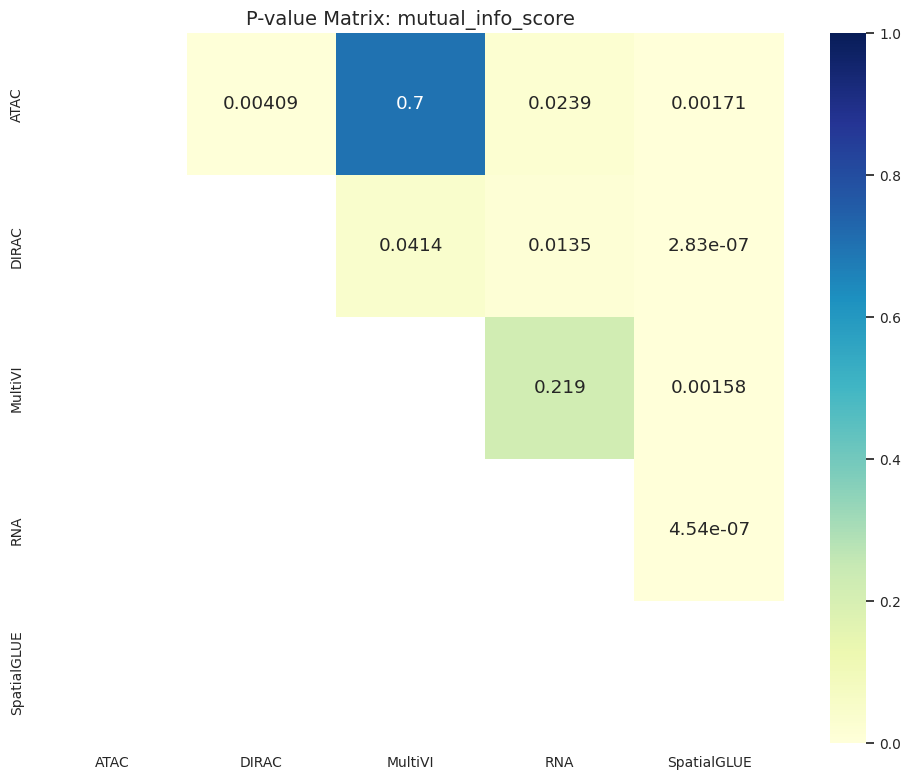

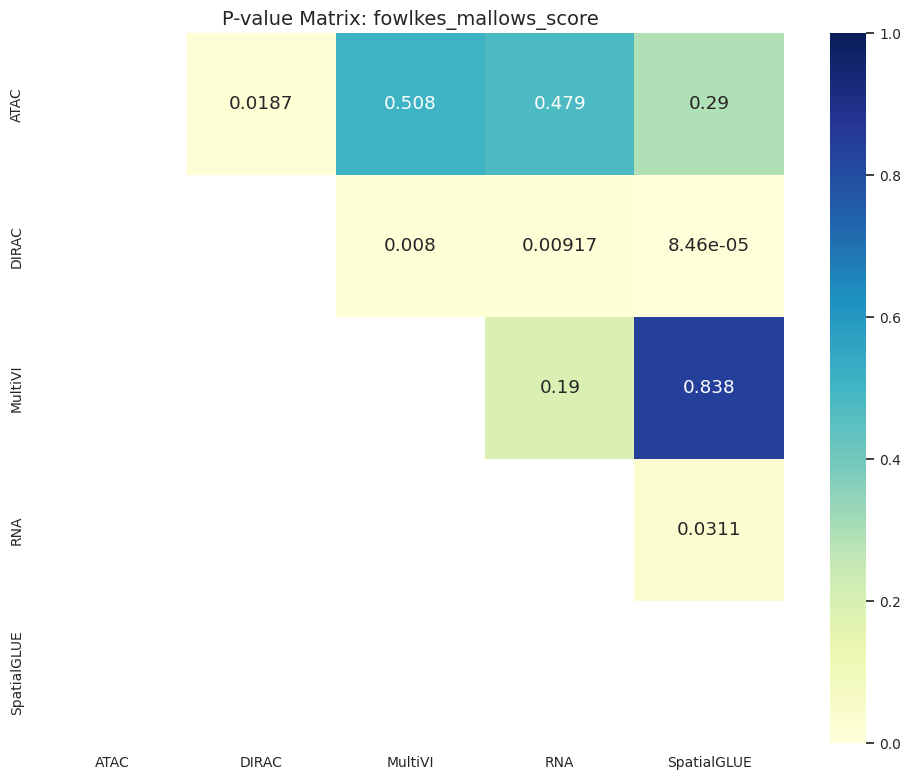

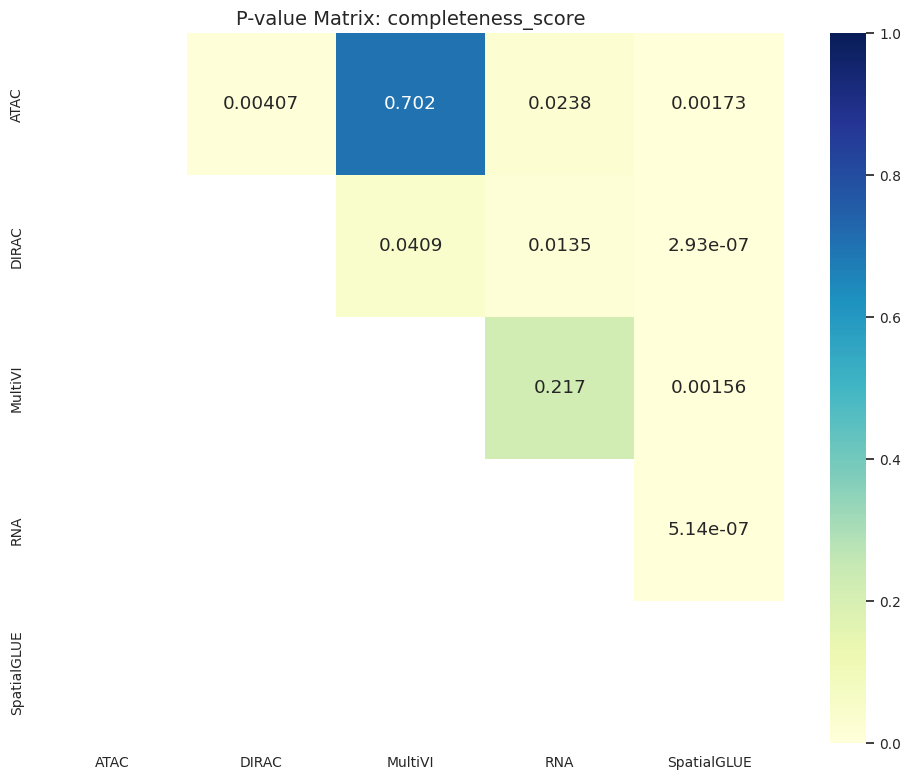

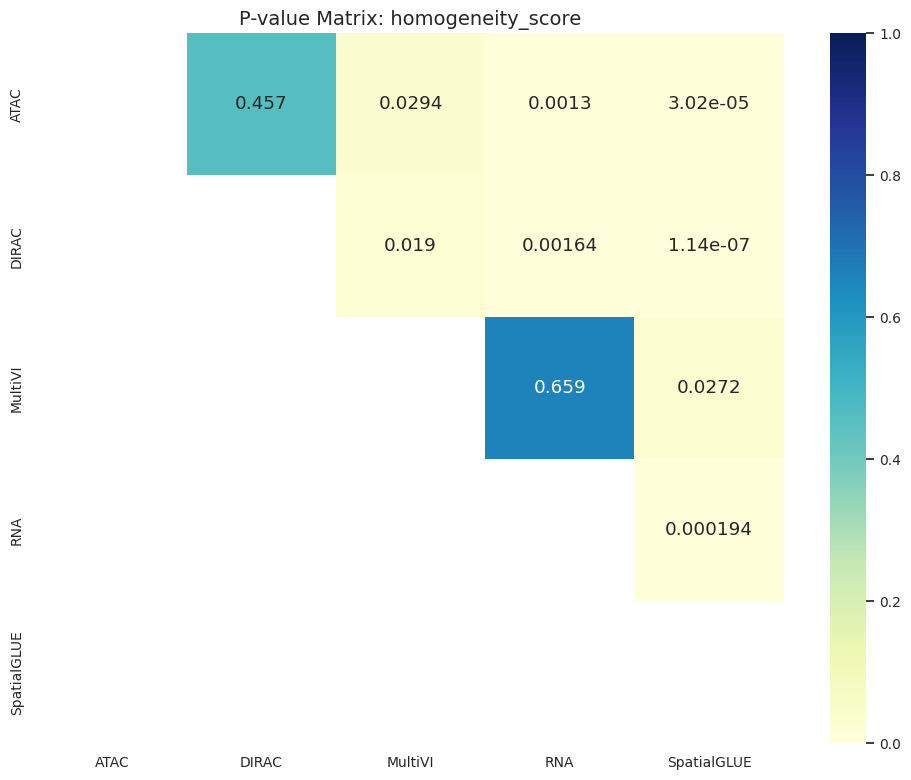

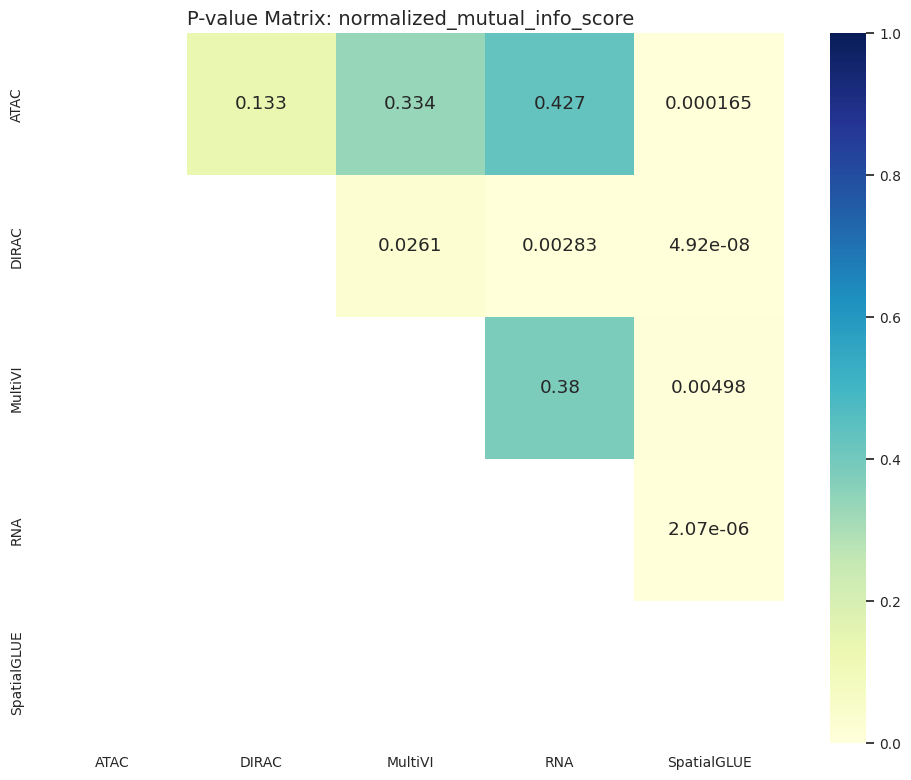

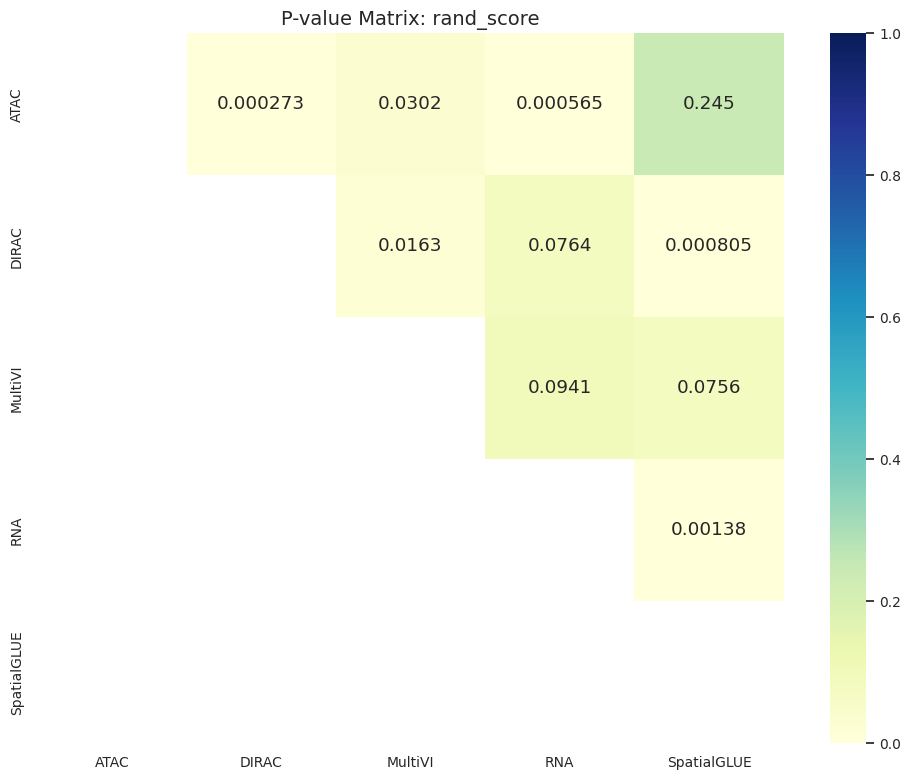

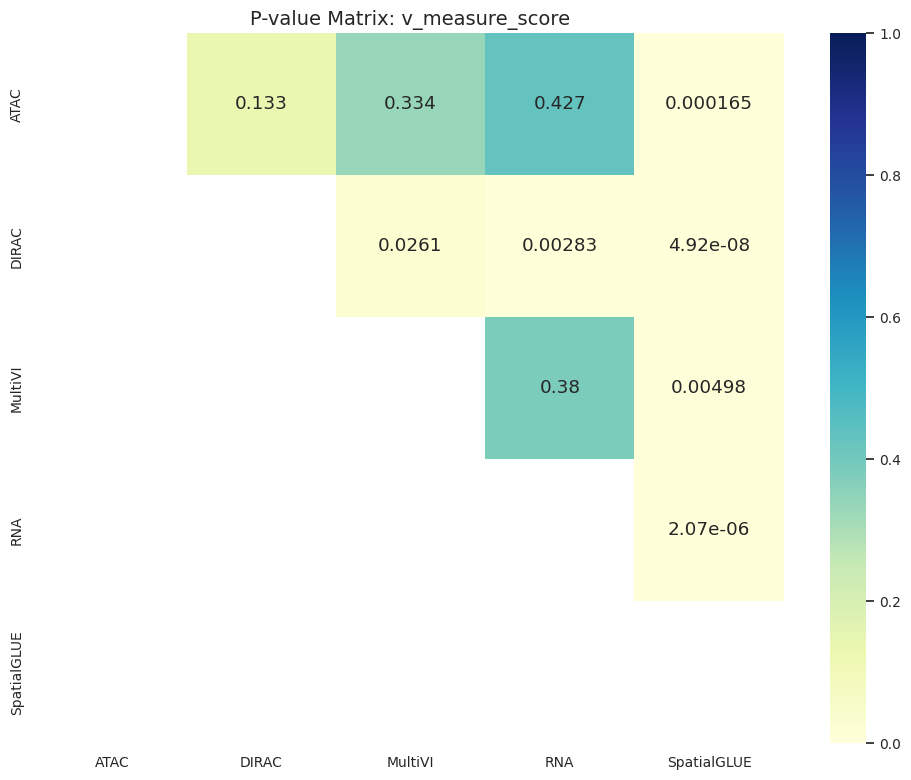

In [7]:
from itertools import combinations
# Step 1: Calculate mean and variance for each method across numeric columns
numeric_cols = summary_df.select_dtypes(include=['number']).columns.tolist()

# Group by 'Method' and compute mean and variance
method_stats = summary_df.groupby('Method')[numeric_cols].agg(['mean', 'var'])

# Flatten multi-level column names
method_stats.columns = ['_'.join(col).strip() for col in method_stats.columns.values]
method_stats = method_stats.reset_index()

# Save method statistics to CSV
method_stats.to_csv(os.path.join(result_path, "sim_scMultiSim_stats.csv"), index=False)

print("\nMethod statistics (mean and variance):")
print(method_stats)

# Step 2: Function to calculate all pairwise t-test p-values between methods
# Step 2: Function to calculate all pairwise t-test p-values between methods (with means/variances)
def calculate_all_pairwise_p_values(df, metrics):
    p_values = []

    # Precompute mean and variance for each method and metric
    stats_df = df.groupby('Method')[metrics].agg(['mean', 'var'])

    for metric in metrics:
        # Create a pivot table: rows = datasets, columns = methods, values = metric scores
        metric_df = df[['Dataset', 'Method', metric]].copy()
        pivot_df = metric_df.pivot(index='Dataset', columns='Method', values=metric)

        methods = pivot_df.columns.tolist()

        # Compare every pair of methods
        for method_a, method_b in combinations(methods, 2):
            try:
                # Remove rows with missing values for this method pair
                paired_data = pivot_df[[method_a, method_b]].dropna()
                if len(paired_data) > 1:
                    t_stat, p_val = ttest_rel(
                        paired_data[method_a],
                        paired_data[method_b],
                        alternative='two-sided'
                    )

                    # Get stats for Method_A
                    mean_a = stats_df.loc[method_a, (metric, 'mean')]
                    var_a = stats_df.loc[method_a, (metric, 'var')]

                    # Get stats for Method_B
                    mean_b = stats_df.loc[method_b, (metric, 'mean')]
                    var_b = stats_df.loc[method_b, (metric, 'var')]

                    p_values.append({
                        'Metric': metric,
                        'Comparison': f"{method_a} vs {method_b}",
                        'Method_A': method_a,
                        'Mean_A': mean_a,
                        'Var_A': var_a,
                        'Method_B': method_b,
                        'Mean_B': mean_b,
                        'Var_B': var_b,
                        'p_value': p_val
                    })
            except Exception as e:
                print(f"Error comparing {method_a} vs {method_b} for {metric}: {str(e)}")

    return pd.DataFrame(p_values)

# Step 3: List of metrics to evaluate
metrics = [
    'adjusted_mutual_info_score', 'adjusted_rand_score', 'mutual_info_score',
    'fowlkes_mallows_score', 'completeness_score', 'homogeneity_score',
    'normalized_mutual_info_score', 'rand_score', 'v_measure_score'
]

# Step 4: Run the pairwise p-value calculation
p_value_df = calculate_all_pairwise_p_values(summary_df, metrics)
p_value_df.to_csv(os.path.join(result_path, "scMultiSim_p_values_all_pairs.csv"), index=False)

print("\nAll pairwise p-values between methods:")
print(p_value_df)

# Step 5: Create heatmaps for each metric's p-value matrix
for metric in metrics:
    subset = p_value_df[p_value_df['Metric'] == metric]
    if not subset.empty:
        # Create square matrix (methods x methods) with p-values
        methods = sorted(set(subset['Method_A']).union(set(subset['Method_B'])))
        heatmap_matrix = pd.DataFrame(index=methods, columns=methods, dtype=float)

        # Fill upper triangle
        for _, row in subset.iterrows():
            heatmap_matrix.loc[row['Method_A'], row['Method_B']] = row['p_value']

        # Plot heatmap
        plt.figure(figsize=(10, 8))
        sns.heatmap(heatmap_matrix, annot=True, fmt=".3g", cmap="YlGnBu", vmin=0, vmax=1)
        plt.title(f"P-value Matrix: {metric}", fontsize=14)
        plt.tight_layout()
        plt.savefig(os.path.join(result_path, f"scMultiSim_p_values_matrix_{metric}.pdf"), dpi=300)
        plt.show()

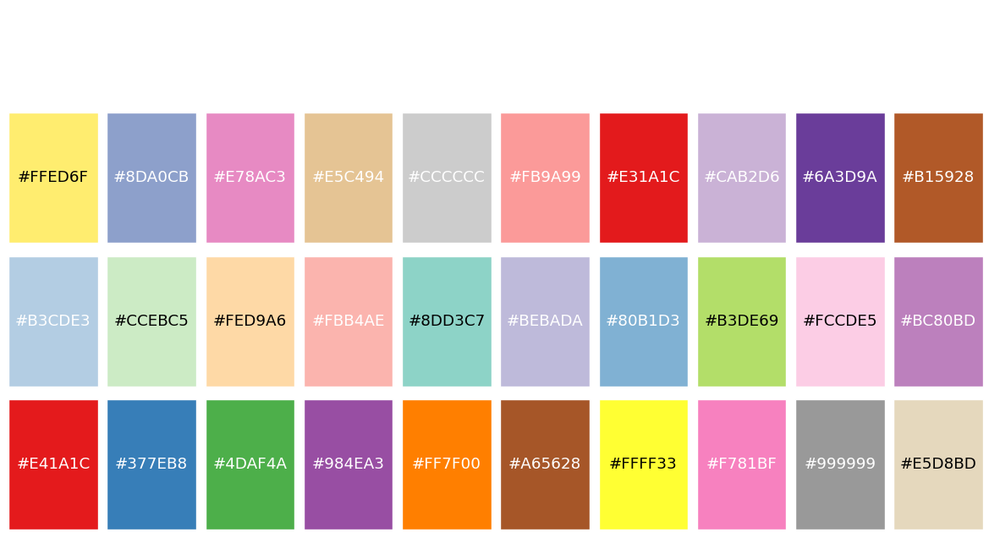

In [9]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

colormaps = [
    "#E41A1C", "#377EB8", "#4DAF4A", "#984EA3", "#FF7F00", "#A65628", "#FFFF33", "#F781BF", "#999999",
    "#E5D8BD", "#B3CDE3", "#CCEBC5", "#FED9A6", "#FBB4AE", "#8DD3C7", "#BEBADA", "#80B1D3", "#B3DE69", "#FCCDE5",
    "#BC80BD", "#FFED6F", "#8DA0CB", "#E78AC3", "#E5C494", "#CCCCCC", "#FB9A99", "#E31A1C", "#CAB2D6", "#6A3D9A", 
    "#B15928"
]

fig, ax = plt.subplots(figsize=(15, 8))
for i, color in enumerate(colormaps):
    rect = patches.Rectangle((i % 10 * 1.1, i // 10 * 1.1), 1, 1, facecolor=color)
    ax.add_patch(rect)
    ax.text(i % 10 * 1.1 + 0.5, i // 10 * 1.1 + 0.5, color, 
            ha='center', va='center', 
            color='black' if color in ['#FFFF33', '#FFED6F', '#E5D8BD', '#CCEBC5', '#FED9A6', '#FCCDE5', '#8DD3C7', '#B3DE69'] else 'white')
ax.set_xlim(0, 11)
ax.set_ylim(0, 4)
ax.axis('off')
plt.show()

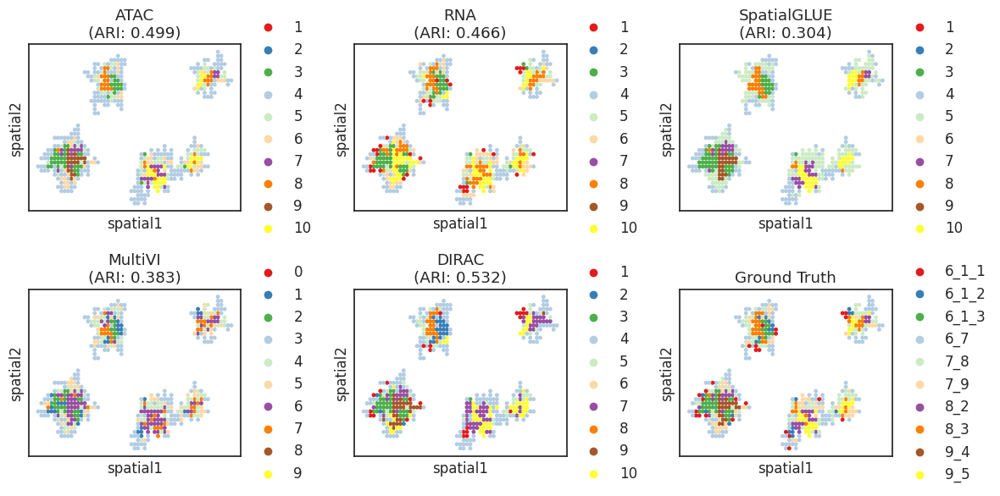

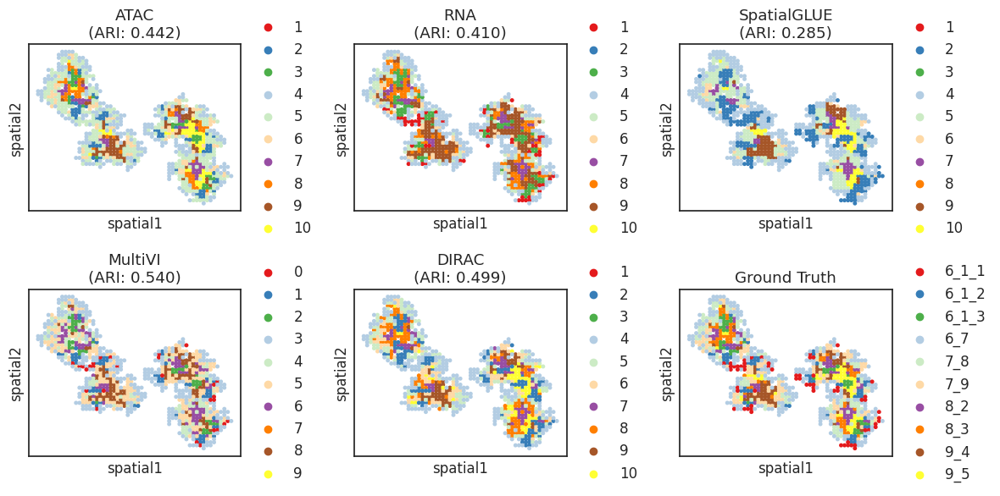

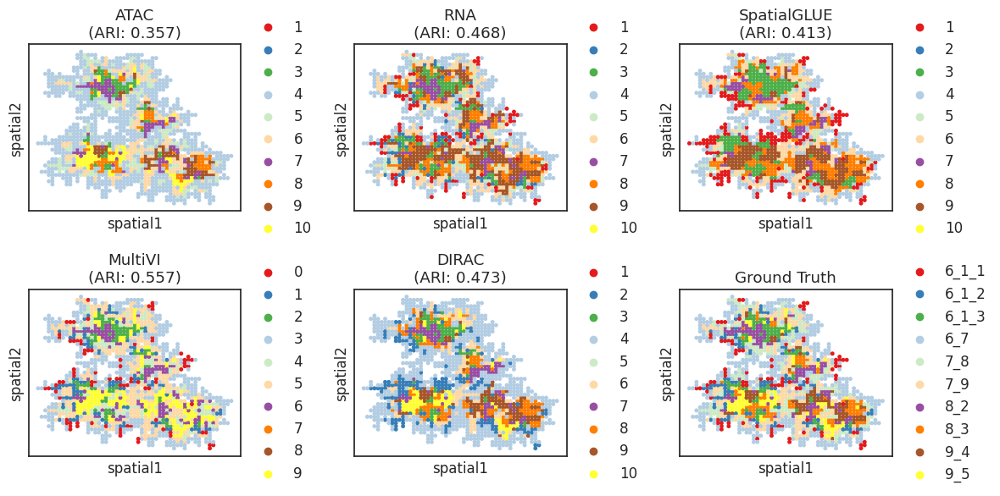

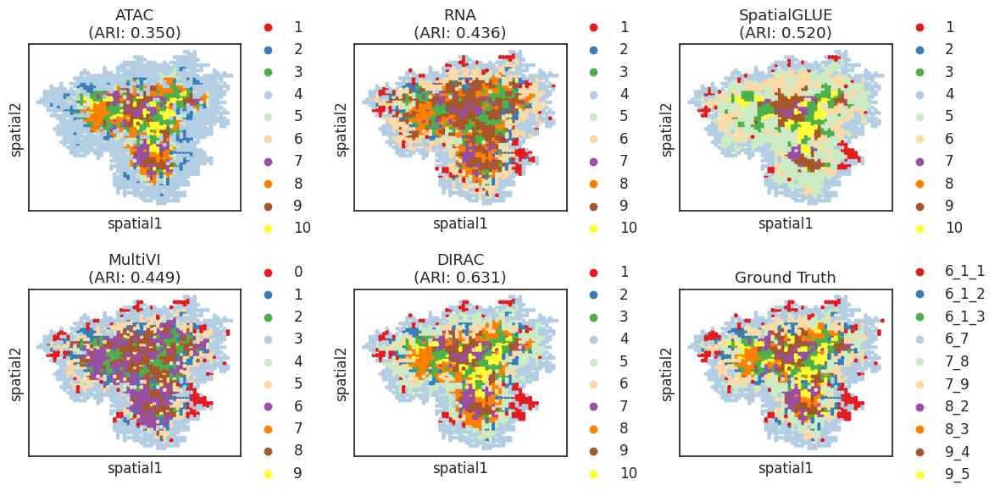

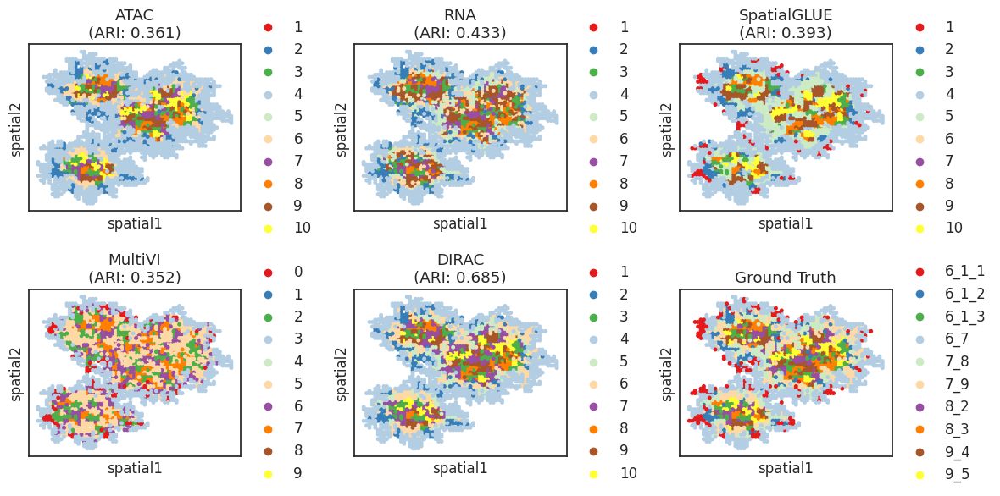

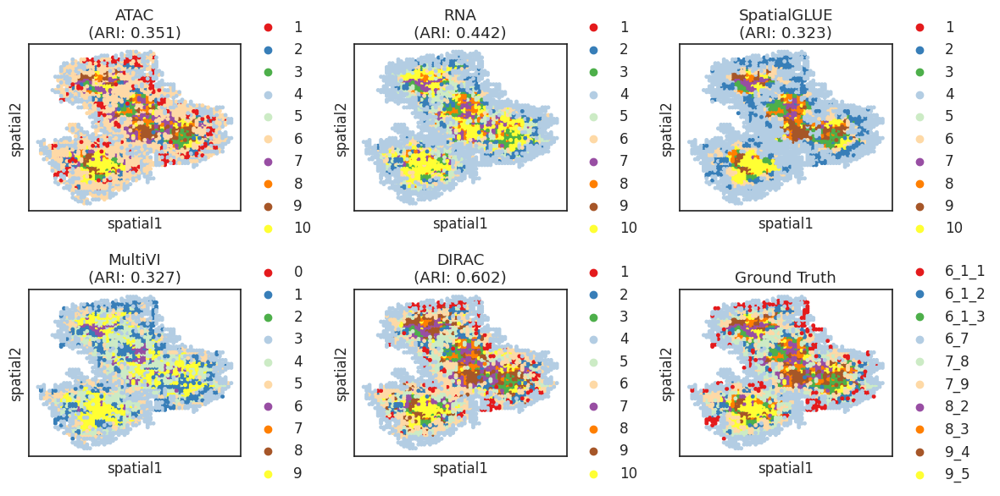

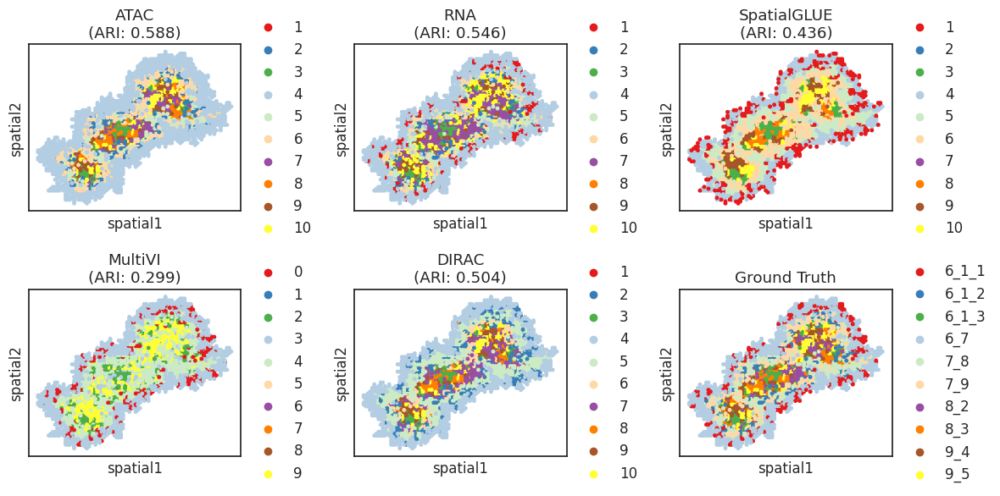

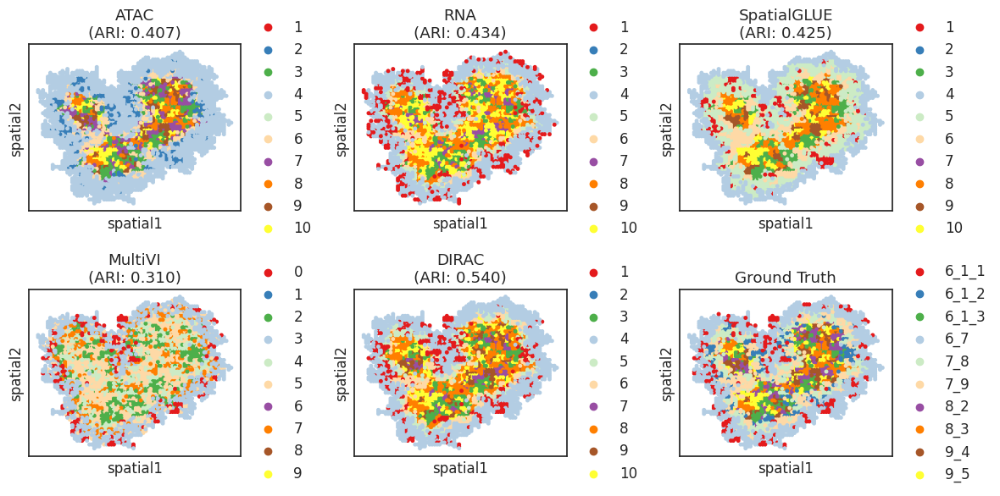

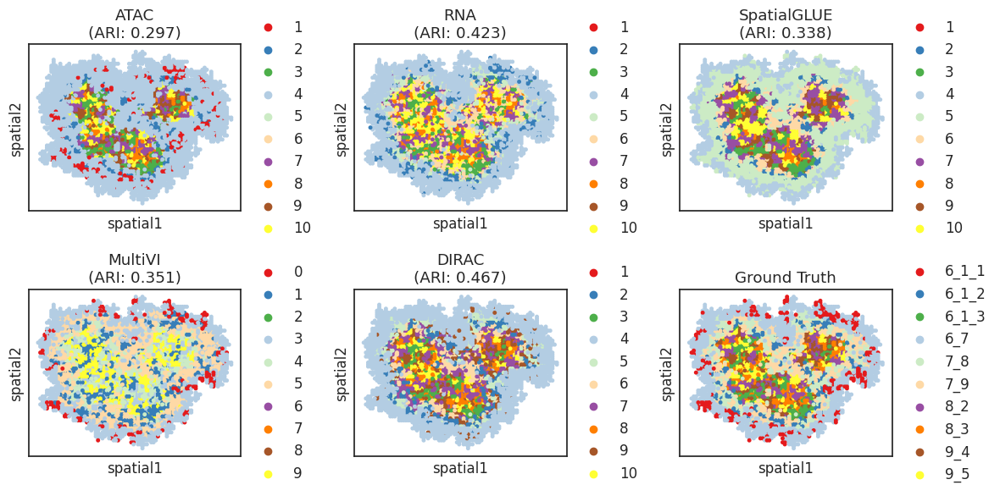

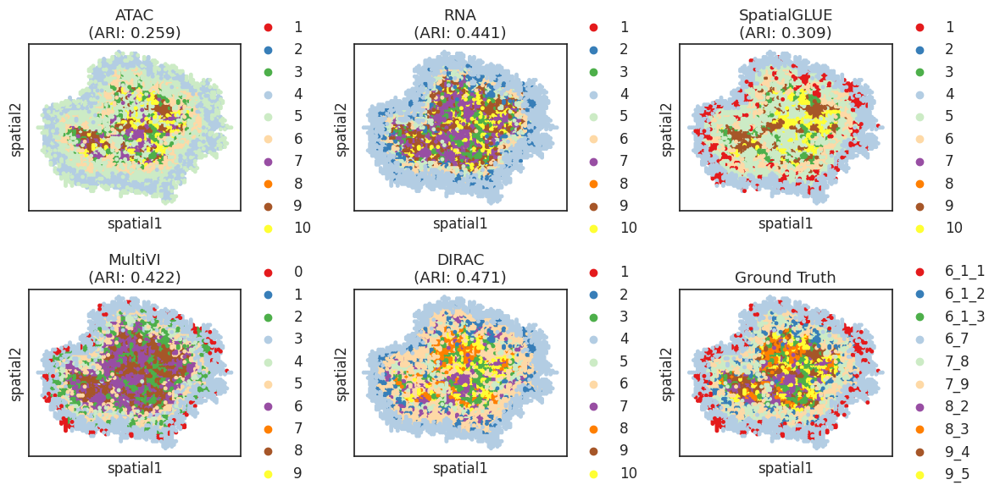

In [10]:
import os
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import adjusted_rand_score
import numpy as np
import matplotlib as mpl
from matplotlib.colors import ListedColormap

mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42

result_path = "/home/users/nus/changxu/scratch/DIRAC/Section-2/Results"
data_name_list = [f"sim_{i+1}" for i in range(10)]
methods_list = ["ATAC", "RNA", "SpatialGLUE", "MultiVI", "DIRAC"] 
data_path = "/home/project/11003054/changxu/Projects/DIRAC/Section-2/scMultiSim_data"

colormaps = [
    "#E41A1C", "#377EB8", "#4DAF4A", "#B3CDE3", "#CCEBC5", "#FED9A6", "#984EA3", "#FF7F00", "#A65628", "#FFFF33", "#F781BF", "#999999",
    "#E5D8BD",  "#FBB4AE", "#8DD3C7", "#BEBADA", "#80B1D3", "#B3DE69", "#FCCDE5",
    "#BC80BD", "#FFED6F", "#8DA0CB", "#E78AC3", "#E5C494", "#CCCCCC", "#FB9A99", "#E31A1C", "#CAB2D6", "#6A3D9A", 
    "#B15928"
]


def create_cluster_colormap(pred_labels, true_labels, true_colors):
    """Create color mapping where each predicted cluster gets color of its dominant true type"""
    unique_preds = np.unique(pred_labels)
    unique_trues = np.unique(true_labels)
    
    df = pd.DataFrame({'pred': pred_labels, 'true': true_labels})
    
    cluster_to_true = {}
    for pred_cluster in unique_preds:
        cluster_true = df[df['pred'] == pred_cluster]['true']
        if len(cluster_true) > 0:
            dominant_true = cluster_true.value_counts().idxmax()
            cluster_to_true[pred_cluster] = dominant_true
        else:
            cluster_to_true[pred_cluster] = unique_trues[0]
    
    cell_colors = []
    for label in pred_labels:
        matched_true = cluster_to_true.get(label, label)
        cell_colors.append(true_colors.get(matched_true, 'gray'))
    
    return cell_colors, cluster_to_true

for i in range(10):
    adata = sc.read(os.path.join(data_path, data_name_list[i], "sim_RNA.h5ad"))
    
    true_types = adata.obs['cell.type'].astype('category')
    true_categories = true_types.cat.categories
    n_true_types = len(true_categories)

    # Use custom colormaps
    if n_true_types <= len(colormaps):
        true_palette = colormaps[:n_true_types]
    else:
        raise ValueError(f"Not enough colors in colormaps for {n_true_types} unique cell types.")
    
    true_color_map = dict(zip(true_categories, true_palette))
    
    n_methods = len(methods_list)
    n_rows = 2
    n_cols = 3
    fig, axs = plt.subplots(n_rows, n_cols, figsize=(4*n_cols, 3*n_rows))
    axs = axs.ravel()
    
    # Ground truth plot
    sc.pl.embedding(
        adata,
        basis='spatial',
        color="cell.type",
        title="Ground Truth",
        s=50,
        show=False,
        palette=true_palette,
        ax=axs[-1]
    )
    
    for j_idx, j in enumerate(methods_list):
        df = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_scMultiSim_{j}", f"{data_name_list[i]}_{j}.csv"))
        
        if j == 'MultiVI':
            df.columns = ['Barcode', j]
            df['Barcode'] = df['Barcode'].str.split('_').str[0]
            df = df.set_index('Barcode').reindex(adata.obs_names).reset_index()
        
        pred_labels = df[j].astype(str).values
        adata.obs[j] = pred_labels
        
        ARI = adjusted_rand_score(pred_labels, adata.obs['cell.type'])
        cell_colors, _ = create_cluster_colormap(pred_labels, adata.obs['cell.type'], true_color_map)
        
        sc.pl.embedding(
            adata,
            basis='spatial',
            color=j,
            title=f"{j}\n(ARI: {ARI:.3f})",
            s=50,
            show=False,
            color_map=ListedColormap(true_palette),
            palette=true_palette,
            ax=axs[j_idx]
        )
        
        axs[j_idx].collections[0].set_facecolor(cell_colors)
    
    for k in range(len(methods_list)+1, n_rows*n_cols):
        axs[k].axis('off')
    
    plt.tight_layout()
    plt.savefig(os.path.join("/home/users/nus/changxu/scratch/DIRAC/Section-2/PDF", f"{data_name_list[i]}_scMultiSim.pdf"), 
                dpi=300, bbox_inches='tight')

In [1]:
####### calculate omic mixing and biological preservation
r"""
Performance evaluation metrics
"""
from typing import Tuple

import numpy as np
import pandas as pd
import scanpy as sc
import scipy.spatial
import sklearn.metrics
import sklearn.neighbors
from anndata import AnnData
from scipy.sparse.csgraph import connected_components
from typing import Any, Mapping, Optional, TypeVar, Union

RandomState = Optional[Union[np.random.RandomState, int]]

def get_rs(x: RandomState = None) -> np.random.RandomState:
    r"""
    Get random state object

    Parameters
    ----------
    x
        Object that can be converted to a random state object

    Returns
    -------
    rs
        Random state object
    """
    if isinstance(x, int):
        return np.random.RandomState(x)
    if isinstance(x, np.random.RandomState):
        return x
    return np.random



def mean_average_precision(
    x: np.ndarray, y: np.ndarray, neighbor_frac: float = 0.01, **kwargs
) -> float:
    r"""
    Mean average precision

    Parameters
    ----------
    x
        Coordinates
    y
        Cell type labels
    neighbor_frac
        Nearest neighbor fraction
    **kwargs
        Additional keyword arguments are passed to
        :class:`sklearn.neighbors.NearestNeighbors`

    Returns
    -------
    map
        Mean average precision
    """
    k = max(round(y.shape[0] * neighbor_frac), 1)
    nn = sklearn.neighbors.NearestNeighbors(
        n_neighbors=min(y.shape[0], k + 1), **kwargs
    ).fit(x)
    nni = nn.kneighbors(x, return_distance=False)
    match = np.equal(y[nni[:, 1:]], np.expand_dims(y, 1))
    return np.apply_along_axis(_average_precision, 1, match).mean().item()


def _average_precision(match: np.ndarray) -> float:
    if np.any(match):
        cummean = np.cumsum(match) / (np.arange(match.size) + 1)
        return cummean[match].mean().item()
    return 0.0


def avg_silhouette_width(x: np.ndarray, y: np.ndarray, **kwargs) -> float:
    r"""
    Cell type average silhouette width

    Parameters
    ----------
    x
        Coordinates
    y
        Cell type labels
    **kwargs
        Additional keyword arguments are passed to
        :func:`sklearn.metrics.silhouette_score`

    Returns
    -------
    asw
        Cell type average silhouette width

    Note
    ----
    Follows the definition in `OpenProblems NeurIPS 2021 competition
    <https://openproblems.bio/neurips_docs/about_tasks/task3_joint_embedding/>`__
    """
    return (sklearn.metrics.silhouette_score(x, y, **kwargs).item() + 1) / 2


def graph_connectivity(x: np.ndarray, y: np.ndarray, **kwargs) -> float:
    r"""
    Graph connectivity

    Parameters
    ----------
    x
        Coordinates
    y
        Cell type labels
    **kwargs
        Additional keyword arguments are passed to
        :func:`scanpy.pp.neighbors`

    Returns
    -------
    conn
        Graph connectivity
    """
    x = AnnData(X=x, dtype=x.dtype)
    sc.pp.neighbors(x, n_pcs=0, use_rep="X", **kwargs)
    conns = []
    for y_ in np.unique(y):
        x_ = x[y == y_]
        _, c = connected_components(x_.obsp["connectivities"], connection="strong")
        counts = pd.value_counts(c)
        conns.append(counts.max() / counts.sum())
    return np.mean(conns).item()


def seurat_alignment_score(
    x: np.ndarray,
    y: np.ndarray,
    neighbor_frac: float = 0.01,
    n_repeats: int = 4,
    random_state: RandomState = None,
    **kwargs
) -> float:
    r"""
    Seurat alignment score

    Parameters
    ----------
    x
        Coordinates
    y
        Batch labels
    neighbor_frac
        Nearest neighbor fraction
    n_repeats
        Number of subsampling repeats
    random_state
        Random state
    **kwargs
        Additional keyword arguments are passed to
        :class:`sklearn.neighbors.NearestNeighbors`

    Returns
    -------
    sas
        Seurat alignment score
    """
    rs = get_rs(random_state)
    idx_list = [np.where(y == u)[0] for u in np.unique(y)]
    min_size = min(idx.size for idx in idx_list)
    repeat_scores = []
    for _ in range(n_repeats):
        subsample_idx = np.concatenate(
            [rs.choice(idx, min_size, replace=False) for idx in idx_list]
        )
        subsample_x = x[subsample_idx]
        subsample_y = y[subsample_idx]
        k = max(round(subsample_idx.size * neighbor_frac), 1)
        nn = sklearn.neighbors.NearestNeighbors(n_neighbors=k + 1, **kwargs).fit(
            subsample_x
        )
        nni = nn.kneighbors(subsample_x, return_distance=False)
        same_y_hits = (
            (subsample_y[nni[:, 1:]] == np.expand_dims(subsample_y, axis=1))
            .sum(axis=1)
            .mean()
        )
        repeat_score = (k - same_y_hits) * len(idx_list) / (k * (len(idx_list) - 1))
        repeat_scores.append(
            min(repeat_score, 1)
        )  # score may exceed 1, if same_y_hits is lower than expected by chance
    return np.mean(repeat_scores).item()


def avg_silhouette_width_batch(
    x: np.ndarray, y: np.ndarray, ct: np.ndarray, **kwargs
) -> float:
    r"""
    Batch average silhouette width

    Parameters
    ----------
    x
        Coordinates
    y
        Batch labels
    ct
        Cell type labels
    **kwargs
        Additional keyword arguments are passed to
        :func:`sklearn.metrics.silhouette_samples`

    Returns
    -------
    asw_batch
        Batch average silhouette width

    Note
    ----
    Follows the definition in `OpenProblems NeurIPS 2021 competition
    <https://openproblems.bio/neurips_docs/about_tasks/task3_joint_embedding/>`__
    """
    s_per_ct = []
    for t in np.unique(ct):
        mask = ct == t
        try:
            s = sklearn.metrics.silhouette_samples(x[mask], y[mask], **kwargs)
        except ValueError:  # Too few samples
            s = 0
        s = (1 - np.fabs(s)).mean()
        s_per_ct.append(s)
    return np.mean(s_per_ct).item()


def neighbor_conservation(
    x: np.ndarray,
    y: np.ndarray,
    batch: np.ndarray,
    neighbor_frac: float = 0.01,
    **kwargs
) -> float:
    r"""
    Neighbor conservation score

    Parameters
    ----------
    x
        Coordinates after integration
    y
        Coordinates before integration
    b
        Batch
    **kwargs
        Additional keyword arguments are passed to
        :class:`sklearn.neighbors.NearestNeighbors`

    Returns
    -------
    nn_cons
        Neighbor conservation score
    """
    nn_cons_per_batch = []
    for b in np.unique(batch):
        mask = batch == b
        x_, y_ = x[mask], y[mask]
        k = max(round(x.shape[0] * neighbor_frac), 1)
        nnx = (
            sklearn.neighbors.NearestNeighbors(
                n_neighbors=min(x_.shape[0], k + 1), **kwargs
            )
            .fit(x_)
            .kneighbors_graph(x_)
        )
        nny = (
            sklearn.neighbors.NearestNeighbors(
                n_neighbors=min(y_.shape[0], k + 1), **kwargs
            )
            .fit(y_)
            .kneighbors_graph(y_)
        )
        nnx.setdiag(0)  # Remove self
        nny.setdiag(0)  # Remove self
        n_intersection = nnx.multiply(nny).sum(axis=1).A1
        n_union = (nnx + nny).astype(bool).sum(axis=1).A1
        nn_cons_per_batch.append((n_intersection / n_union).mean())
    return np.mean(nn_cons_per_batch).item()


def foscttm(x: np.ndarray, y: np.ndarray, **kwargs) -> Tuple[np.ndarray, np.ndarray]:
    r"""
    Fraction of samples closer than true match (smaller is better)

    Parameters
    ----------
    x
        Coordinates for samples in modality X
    y
        Coordinates for samples in modality y
    **kwargs
        Additional keyword arguments are passed to
        :func:`scipy.spatial.distance_matrix`

    Returns
    -------
    foscttm_x, foscttm_y
        FOSCTTM for samples in modality X and Y, respectively

    Note
    ----
    Samples in modality X and Y should be paired and given in the same order
    """
    if x.shape != y.shape:
        raise ValueError("Shapes do not match!")
    d = scipy.spatial.distance_matrix(x, y, **kwargs)
    foscttm_x = (d < np.expand_dims(np.diag(d), axis=1)).mean(axis=1)
    foscttm_y = (d < np.expand_dims(np.diag(d), axis=0)).mean(axis=0)
    return foscttm_x, foscttm_y

In [19]:
import os 
import scanpy as sc 
import numpy as np
import functools

import yaml
import argparse
import functools
import pathlib
import scipy.stats as stats

import anndata
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42

result_path = "/home/users/nus/changxu/scratch/DIRAC/Section-2/Results"
data_name_list = [f"sim_{i+1}" for i in range(10)]
methods_list = ["MultiVI", "SpatialGLUE", "DIRAC"]   
data_path = "/home/project/11003054/changxu/Projects/DIRAC/Section-2/simulations/sp_multi_omics_final"

gt = "ground_truth"

results_list = []

for i in range(len(data_name_list)):
    for j in range(len(methods_list)):
        adata = sc.read(os.path.join(data_path, f"{data_name_list[i]}", "sim_RNA.h5ad"))
        if methods_list[j] == "SpatialGLUE_3M":
            df_RNA = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_SpatialGLUE", f"{data_name_list[i]}_SpatialGLUE_RNA_3M.csv"), index_col=0)
            df_ADT = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_SpatialGLUE", f"{data_name_list[i]}_SpatialGLUE_ADT_3M.csv"), index_col=0)
            df_ATAC = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_SpatialGLUE", f"{data_name_list[i]}_SpatialGLUE_ATAC_3M.csv"), index_col=0)
            df_RNA["batch"] = "RNA"
            df_ADT["batch"] = "ADT"
            df_ATAC["batch"] = "ATAC"
            methods = "SpatialGLUE"
            save_clustering_results = os.path.join(result_path, f"{data_name_list[i]}_SpatialGLUE", "BR_3M.yaml")
            df = pd.concat([df_RNA, df_ADT, df_ATAC], ignore_index=True)
            ct = adata.obs['ground_truth'].repeat(3).reset_index(drop=True)
        elif methods_list[j] == "DIRAC_3M":
            df_RNA = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_DIRAC", f"{data_name_list[i]}_DIRAC_RNA_3M.csv"), index_col=0)
            df_ADT = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_DIRAC", f"{data_name_list[i]}_DIRAC_ADT_3M.csv"), index_col=0)
            df_ATAC = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_DIRAC", f"{data_name_list[i]}_DIRAC_ATAC_3M.csv"), index_col=0)
            df_RNA["batch"] = "RNA"
            df_ADT["batch"] = "ADT"
            df_ATAC["batch"] = "ATAC"
            methods = "DIRAC"
            save_clustering_results = os.path.join(result_path, f"{data_name_list[i]}_DIRAC", "BR_3M.yaml")
            df = pd.concat([df_RNA, df_ADT, df_ATAC], ignore_index=True)
            ct = pd.concat([adata.obs['ground_truth']] * 3, ignore_index=True)
        else:
            df_RNA = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_{methods_list[j]}", f"{data_name_list[i]}_{methods_list[j]}_RNA.csv"), index_col=0)
            df_ADT = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_{methods_list[j]}", f"{data_name_list[i]}_{methods_list[j]}_ADT.csv"), index_col=0)
            df_RNA["batch"] = "RNA"
            df_ADT["batch"] = "ADT"            
            methods = methods_list[j]
            save_clustering_results = os.path.join(result_path, f"{data_name_list[i]}_{methods_list[j]}", "BR.yaml")
            df = pd.concat([df_RNA, df_ADT], ignore_index=True)
            ct = pd.concat([adata.obs['ground_truth']] * 2, ignore_index=True)
   
        # Convert NumPy objects to Python types
        metrics_clustering = {
            "Dataset": data_name_list[i],
            "Method": methods_list[j],
            "graph_connectivity": float(graph_connectivity(df.iloc[:, :-1].values, df['batch'].values)),
            "seurat_alignment_score": float(seurat_alignment_score(df.iloc[:, :-1].values, df['batch'].values,random_state=0)),
            "avg_silhouette_width_batch": float(avg_silhouette_width_batch(df.iloc[:, :-1].values, df['batch'].values, ct.values)),
         }
        print(metrics_clustering)
        with open(save_clustering_results, "w", encoding="utf-8") as g:
            yaml.dump(metrics_clustering, g, default_flow_style=False, allow_unicode=True)

        results_list.append(metrics_clustering)
        
summary_df = pd.DataFrame(results_list)
metrics = ["graph_connectivity", "seurat_alignment_score", "avg_silhouette_width_batch"]

for metric in metrics:
    min_val = summary_df[metric].min()
    max_val = summary_df[metric].max()
    summary_df[f"{metric}_scaled"] = (summary_df[metric] - min_val) / (max_val - min_val + 1e-9)

summary_df["BR_score"] = summary_df[[f"{m}_scaled" for m in metrics]].mean(axis=1)

br_summary = summary_df.groupby("Method")["BR_score"].agg(["mean", "var"]).reset_index()
print("BR_score Summary (Mean and Variance) for Each Method:")
print(br_summary)

summary_df.to_csv(os.path.join(result_path, "sim_metrics_BR.csv"))

/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_1', 'Method': 'MultiVI', 'graph_connectivity': 0.9998779296875, 'seurat_alignment_score': 0.00016673018292682928, 'avg_silhouette_width_batch': 0.3894464643959007}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_1', 'Method': 'SpatialGLUE', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.0036978372713414634, 'avg_silhouette_width_batch': 0.5123561287279947}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_1', 'Method': 'DIRAC', 'graph_connectivity': 0.804931640625, 'seurat_alignment_score': 0.6667450695503049, 'avg_silhouette_width_batch': 0.8599880755945563}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_2', 'Method': 'MultiVI', 'graph_connectivity': 0.999267578125, 'seurat_alignment_score': 0.004912585746951219, 'avg_silhouette_width_batch': 0.3089929996212248}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_2', 'Method': 'SpatialGLUE', 'graph_connectivity': 0.9998779296875, 'seurat_alignment_score': 0.007282536204268292, 'avg_silhouette_width_batch': 0.5196700220878576}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_2', 'Method': 'DIRAC', 'graph_connectivity': 0.8277587890625, 'seurat_alignment_score': 0.6335746951219512, 'avg_silhouette_width_batch': 0.8599546804102353}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_3', 'Method': 'MultiVI', 'graph_connectivity': 0.9998779296875, 'seurat_alignment_score': 0.007240853658536586, 'avg_silhouette_width_batch': 0.30435322288795835}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_3', 'Method': 'SpatialGLUE', 'graph_connectivity': 0.9998779296875, 'seurat_alignment_score': 0.007059236852134146, 'avg_silhouette_width_batch': 0.5013130325511402}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_3', 'Method': 'DIRAC', 'graph_connectivity': 0.7996826171875, 'seurat_alignment_score': 0.6911948599466463, 'avg_silhouette_width_batch': 0.8524041532837444}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_4', 'Method': 'MultiVI', 'graph_connectivity': 0.99951171875, 'seurat_alignment_score': 0.010378953887195123, 'avg_silhouette_width_batch': 0.24411218901749066}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_4', 'Method': 'SpatialGLUE', 'graph_connectivity': 0.9998779296875, 'seurat_alignment_score': 0.005109089176829268, 'avg_silhouette_width_batch': 0.5320882666537833}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_4', 'Method': 'DIRAC', 'graph_connectivity': 0.77978515625, 'seurat_alignment_score': 0.6297131049923781, 'avg_silhouette_width_batch': 0.8841485926345858}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_5', 'Method': 'MultiVI', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.0018518959603658536, 'avg_silhouette_width_batch': 0.3202971721080056}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_5', 'Method': 'SpatialGLUE', 'graph_connectivity': 0.9998779296875, 'seurat_alignment_score': 0.005353229801829268, 'avg_silhouette_width_batch': 0.5217847781419082}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_5', 'Method': 'DIRAC', 'graph_connectivity': 0.666259765625, 'seurat_alignment_score': 0.6752751048018293, 'avg_silhouette_width_batch': 0.8906674536445038}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_6', 'Method': 'MultiVI', 'graph_connectivity': 0.9998779296875, 'seurat_alignment_score': 0.0006550114329268293, 'avg_silhouette_width_batch': 0.24283789271245534}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_6', 'Method': 'SpatialGLUE', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.009128477515243903, 'avg_silhouette_width_batch': 0.5042372182540884}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_6', 'Method': 'DIRAC', 'graph_connectivity': 0.804931640625, 'seurat_alignment_score': 0.6237197503810976, 'avg_silhouette_width_batch': 0.8377144156424745}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_7', 'Method': 'MultiVI', 'graph_connectivity': 0.9996337890625, 'seurat_alignment_score': 0.000306664443597561, 'avg_silhouette_width_batch': 0.32883814722150206}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_7', 'Method': 'SpatialGLUE', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.004418349847560976, 'avg_silhouette_width_batch': 0.5005293630609209}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_7', 'Method': 'DIRAC', 'graph_connectivity': 0.7667236328125, 'seurat_alignment_score': 0.6302281821646342, 'avg_silhouette_width_batch': 0.8666551648705276}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_8', 'Method': 'MultiVI', 'graph_connectivity': 0.9998779296875, 'seurat_alignment_score': 0.0004823266006097561, 'avg_silhouette_width_batch': 0.33904850913772866}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_8', 'Method': 'SpatialGLUE', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.0045166015625, 'avg_silhouette_width_batch': 0.5497900562520315}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_8', 'Method': 'DIRAC', 'graph_connectivity': 0.7581787109375, 'seurat_alignment_score': 0.6531416730182927, 'avg_silhouette_width_batch': 0.8924497809771929}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_9', 'Method': 'MultiVI', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.0033703315548780487, 'avg_silhouette_width_batch': 0.22765921236989076}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_9', 'Method': 'SpatialGLUE', 'graph_connectivity': 0.999755859375, 'seurat_alignment_score': 0.0028135718368902437, 'avg_silhouette_width_batch': 0.5316850894039094}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_9', 'Method': 'DIRAC', 'graph_connectivity': 0.75830078125, 'seurat_alignment_score': 0.6766833793826219, 'avg_silhouette_width_batch': 0.8816598194925357}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_10', 'Method': 'MultiVI', 'graph_connectivity': 0.9998779296875, 'seurat_alignment_score': 0.001399342606707317, 'avg_silhouette_width_batch': 0.34295874040856356}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_10', 'Method': 'SpatialGLUE', 'graph_connectivity': 0.99951171875, 'seurat_alignment_score': 0.011861661585365854, 'avg_silhouette_width_batch': 0.5274091340431906}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_10', 'Method': 'DIRAC', 'graph_connectivity': 0.82275390625, 'seurat_alignment_score': 0.6517423304115854, 'avg_silhouette_width_batch': 0.8518318923299049}
BR_score Summary (Mean and Variance) for Each Method:
        Method      mean       var
0        DIRAC  0.748487  0.001457
1      MultiVI  0.373224  0.000634
2  SpatialGLUE  0.482711  0.000060


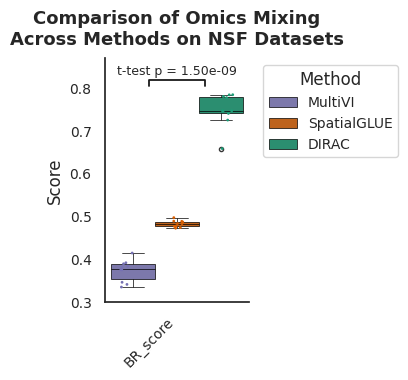

In [20]:
from scipy.stats import ttest_ind
melted_df = summary_df.melt(id_vars=['Dataset', 'Method'], 
                           value_vars=["BR_score"],
                           var_name='Metric', 
                           value_name='Score')

group1 = melted_df[melted_df['Method'] == 'SpatialGLUE']['Score']
group2 = melted_df[melted_df['Method'] == 'DIRAC']['Score']
t_stat, p_value = ttest_ind(group1, group2, equal_var=False)

sns.set(style="white", font_scale=1.1, rc={"axes.labelsize": 12, "xtick.labelsize": 10, "ytick.labelsize": 10})
methods_in_data = melted_df['Method'].unique()
palette_used = {
    "SpatialGLUE": "#d95f02",  
    "DIRAC": "#1b9e77", 
    "MultiVI": "#7570b3", 
}

plt.figure(figsize=(4, 4))
ax = sns.boxplot(
    data=melted_df,
    x='Metric',
    y='Score',
    hue='Method',
    palette=palette_used,
    width=0.7,
    linewidth=0.5,
    fliersize=3,
    boxprops=dict(edgecolor='black'),
    whiskerprops=dict(color='black'),
    capprops=dict(color='black'),
    medianprops=dict(color='black')
)

sns.stripplot(
    data=melted_df,
    x='Metric',
    y='Score',
    hue='Method',
    dodge=True,
    palette=palette_used,
    alpha=1,
    size=2,
    jitter=True,
    marker='o',
    linewidth=0,
    ax=ax
)

handles, labels = ax.get_legend_handles_labels()
plt.legend(handles[:len(methods_in_data)], labels[:len(methods_in_data)],
           title='Method', title_fontsize=12, fontsize=10,
           bbox_to_anchor=(1.05, 1), loc='upper left')

y_max = melted_df['Score'].max()
y, h = y_max + 0.02, 0.015
x1, x2 = -0.15, 0.15
plt.plot([x1, x1, x2, x2], [y, y+h, y+h, y], lw=1.3, c='k')
plt.text((x1 + x2) / 2, y + h + 0.005, f"t-test p = {p_value:.2e}", ha='center', va='bottom', fontsize=9)

plt.title('Comparison of Omics Mixing\nAcross Methods on NSF Datasets',
          fontsize=13, weight='bold', pad=10)

plt.xlabel('')
plt.ylabel('Score', fontsize=12)
plt.xticks(rotation=45, ha='right')
ax.set_ylim(bottom=0.3, top=y + h + 0.05)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)

plt.tight_layout()
plt.savefig(os.path.join(result_path, "sim_metrics_BR_with_ttest.pdf"), dpi=300)
plt.show()


In [17]:
import os 
import scanpy as sc 
import numpy as np
import functools

import yaml
import argparse
import functools
import pathlib
import scipy.stats as stats

import anndata
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl

mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42

result_path = "/home/users/nus/changxu/scratch/DIRAC/Section-2/Results"
data_name_list = [f"sim_{i+1}" for i in range(10)]
methods_list = ["MultiVI", "SpatialGLUE", "DIRAC"]
data_path = "/home/project/11003054/changxu/Projects/DIRAC/Section-2/scMultiSim_data"

gt = "cell.type"

results_list = []

for i in range(len(data_name_list)):
    for j in range(len(methods_list)):
        adata = sc.read(os.path.join(data_path, f"{data_name_list[i]}", "sim_RNA.h5ad"))
        df_RNA = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_scMultiSim_{methods_list[j]}", f"{data_name_list[i]}_{methods_list[j]}_RNA.csv"), index_col=0)
        df_ATAC = pd.read_csv(os.path.join(result_path, f"{data_name_list[i]}_scMultiSim_{methods_list[j]}", f"{data_name_list[i]}_{methods_list[j]}_ADT.csv"), index_col=0)
        df_RNA["batch"] = "RNA"
        df_ATAC["batch"] = "ATAC"            
        methods = methods_list[j]
        save_clustering_results = os.path.join(result_path, f"{data_name_list[i]}_{methods_list[j]}", "BR.yaml")
        df = pd.concat([df_RNA, df_ATAC], ignore_index=True)
        ct = pd.concat([adata.obs[gt]] * 2, ignore_index=True)
   
        # Convert NumPy objects to Python types
        metrics_clustering = {
            "Dataset": data_name_list[i],
            "Method": methods_list[j],
            "graph_connectivity": float(graph_connectivity(df.iloc[:, :-1].values, df['batch'].values)),
            "seurat_alignment_score": float(seurat_alignment_score(df.iloc[:, :-1].values, df['batch'].values.ravel(), random_state=1)),
            "avg_silhouette_width_batch": float(avg_silhouette_width_batch(df.iloc[:, :-1].values, df['batch'].values.ravel(), ct.values.ravel())),
         }
        print(metrics_clustering)
        with open(save_clustering_results, "w", encoding="utf-8") as g:
            yaml.dump(metrics_clustering, g, default_flow_style=False, allow_unicode=True)

        results_list.append(metrics_clustering)
        
summary_df = pd.DataFrame(results_list)
metrics = ["graph_connectivity", "seurat_alignment_score", "avg_silhouette_width_batch"]

for metric in metrics:
    min_val = summary_df[metric].min()
    max_val = summary_df[metric].max()
    summary_df[f"{metric}_scaled"] = (summary_df[metric] - min_val) / (max_val - min_val + 1e-9)

summary_df["BR_score"] = summary_df[[f"{m}_scaled" for m in metrics]].mean(axis=1)

br_summary = summary_df.groupby("Method")["BR_score"].agg(["mean", "var"]).reset_index()
print("BR_score Summary (Mean and Variance) for Each Method:")
print(br_summary)
summary_df.to_csv(os.path.join(result_path, "scMultiSim_metrics_BR.csv"))

/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


{'Dataset': 'sim_1', 'Method': 'MultiVI', 'graph_connectivity': 0.999, 'seurat_alignment_score': 0.2032, 'avg_silhouette_width_batch': 0.5878892362055741}


/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_1', 'Method': 'SpatialGLUE', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.0010000000000001564, 'avg_silhouette_width_batch': 0.6827173800187418}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


{'Dataset': 'sim_1', 'Method': 'DIRAC', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.6567999999999999, 'avg_silhouette_width_batch': 0.7691965562727453}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


{'Dataset': 'sim_2', 'Method': 'MultiVI', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.010800000000000054, 'avg_silhouette_width_batch': 0.4117966084662606}


/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_2', 'Method': 'SpatialGLUE', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.0005500000000001392, 'avg_silhouette_width_batch': 0.709187131564373}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_2', 'Method': 'DIRAC', 'graph_connectivity': 0.9450000000000001, 'seurat_alignment_score': 0.3128499999999999, 'avg_silhouette_width_batch': 0.7245296083385758}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_3', 'Method': 'MultiVI', 'graph_connectivity': 0.9043333333333333, 'seurat_alignment_score': 0.027777777777777856, 'avg_silhouette_width_batch': 0.24783957809933216}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_3', 'Method': 'SpatialGLUE', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.0007111111111110328, 'avg_silhouette_width_batch': 0.7018776322238617}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_3', 'Method': 'DIRAC', 'graph_connectivity': 0.9746666666666667, 'seurat_alignment_score': 0.36682222222222216, 'avg_silhouette_width_batch': 0.7855314446262169}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_4', 'Method': 'MultiVI', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.07168750000000017, 'avg_silhouette_width_batch': 0.13687623432978288}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_4', 'Method': 'SpatialGLUE', 'graph_connectivity': 1.0, 'seurat_alignment_score': 6.249999999994316e-05, 'avg_silhouette_width_batch': 0.6759829130347991}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_4', 'Method': 'DIRAC', 'graph_connectivity': 0.9475, 'seurat_alignment_score': 0.36876250000000005, 'avg_silhouette_width_batch': 0.6500190668338817}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_5', 'Method': 'MultiVI', 'graph_connectivity': 0.7812, 'seurat_alignment_score': 0.06457600000000013, 'avg_silhouette_width_batch': 0.1663787174471664}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_5', 'Method': 'SpatialGLUE', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.0008559999999999946, 'avg_silhouette_width_batch': 0.6959085262377712}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_5', 'Method': 'DIRAC', 'graph_connectivity': 0.9996, 'seurat_alignment_score': 0.404752, 'avg_silhouette_width_batch': 0.6759506392663817}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_6', 'Method': 'MultiVI', 'graph_connectivity': 0.9995, 'seurat_alignment_score': 0.09929999999999997, 'avg_silhouette_width_batch': 0.1361212928604793}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_6', 'Method': 'SpatialGLUE', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.0003500000000000133, 'avg_silhouette_width_batch': 0.7033592058190815}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_6', 'Method': 'DIRAC', 'graph_connectivity': 0.9993333333333334, 'seurat_alignment_score': 0.5086555555555556, 'avg_silhouette_width_batch': 0.7555703335075169}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_7', 'Method': 'MultiVI', 'graph_connectivity': 0.7781428571428571, 'seurat_alignment_score': 0.19674285714285722, 'avg_silhouette_width_batch': 0.24060111273971083}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_7', 'Method': 'SpatialGLUE', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.00020408163265293362, 'avg_silhouette_width_batch': 0.7185239520880676}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_7', 'Method': 'DIRAC', 'graph_connectivity': 0.9998571428571428, 'seurat_alignment_score': 0.42024489795918374, 'avg_silhouette_width_batch': 0.7121641608296635}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_8', 'Method': 'MultiVI', 'graph_connectivity': 0.678125, 'seurat_alignment_score': 0.18476250000000008, 'avg_silhouette_width_batch': 0.2897262768781991}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_8', 'Method': 'SpatialGLUE', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.0001531249999999318, 'avg_silhouette_width_batch': 0.6727907162193628}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_8', 'Method': 'DIRAC', 'graph_connectivity': 0.999625, 'seurat_alignment_score': 0.40862499999999996, 'avg_silhouette_width_batch': 0.6630746713901339}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_9', 'Method': 'MultiVI', 'graph_connectivity': 0.7807777777777778, 'seurat_alignment_score': 0.14283703703703704, 'avg_silhouette_width_batch': 0.25748267637563754}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_9', 'Method': 'SpatialGLUE', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.00038765432098778596, 'avg_silhouette_width_batch': 0.7354281471914549}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_9', 'Method': 'DIRAC', 'graph_connectivity': 0.9993333333333333, 'seurat_alignment_score': 0.48102716049382716, 'avg_silhouette_width_batch': 0.7236023379000593}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_10', 'Method': 'MultiVI', 'graph_connectivity': 0.6960999999999999, 'seurat_alignment_score': 0.3856880000000001, 'avg_silhouette_width_batch': 0.24467583355945352}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_10', 'Method': 'SpatialGLUE', 'graph_connectivity': 1.0, 'seurat_alignment_score': 0.00029400000000009643, 'avg_silhouette_width_batch': 0.7011942890154623}


/home/project/11003054/changxu/Conda_envs/dirac-env/lib/python3.9/site-packages/anndata/_core/anndata.py:402: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tmp/ipykernel_1633592/3481038148.py:132: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  counts = pd.value_counts(c)


{'Dataset': 'sim_10', 'Method': 'DIRAC', 'graph_connectivity': 0.9713, 'seurat_alignment_score': 0.43635600000000013, 'avg_silhouette_width_batch': 0.7906213790005786}
BR_score Summary (Mean and Variance) for Each Method:
        Method      mean       var
0        DIRAC  0.837810  0.005978
1      MultiVI  0.329685  0.023612
2  SpatialGLUE  0.620560  0.000096


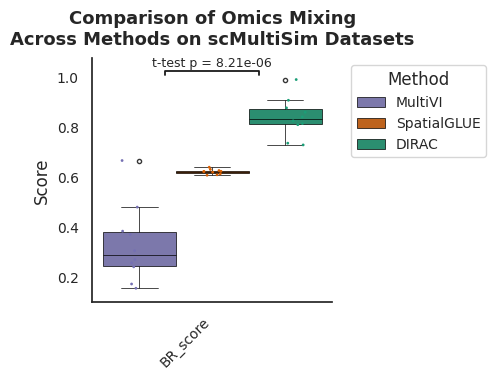

In [18]:
from scipy.stats import ttest_ind
melted_df = summary_df.melt(id_vars=['Dataset', 'Method'], 
                           value_vars=["BR_score"],
                           var_name='Metric', 
                           value_name='Score')

group1 = melted_df[melted_df['Method'] == 'SpatialGLUE']['Score']
group2 = melted_df[melted_df['Method'] == 'DIRAC']['Score']
t_stat, p_value = ttest_ind(group1, group2, equal_var=False)

sns.set(style="white", font_scale=1.1, rc={"axes.labelsize": 12, "xtick.labelsize": 10, "ytick.labelsize": 10})
methods_in_data = melted_df['Method'].unique()
palette_used = {
    "SpatialGLUE": "#d95f02",  
    "DIRAC": "#1b9e77", 
    "MultiVI": "#7570b3", 
}

plt.figure(figsize=(5, 4))
ax = sns.boxplot(
    data=melted_df,
    x='Metric',
    y='Score',
    hue='Method',
    palette=palette_used,
    width=0.7,
    linewidth=0.5,
    fliersize=3,
    boxprops=dict(edgecolor='black'),
    whiskerprops=dict(color='black'),
    capprops=dict(color='black'),
    medianprops=dict(color='black')
)

sns.stripplot(
    data=melted_df,
    x='Metric',
    y='Score',
    hue='Method',
    dodge=True,
    palette=palette_used,
    alpha=1,
    size=2,
    jitter=True,
    marker='o',
    linewidth=0,
    ax=ax
)

handles, labels = ax.get_legend_handles_labels()
plt.legend(handles[:len(methods_in_data)], labels[:len(methods_in_data)],
           title='Method', title_fontsize=12, fontsize=10,
           bbox_to_anchor=(1.05, 1), loc='upper left')

y_max = melted_df['Score'].max()
y, h = y_max + 0.02, 0.015
x1, x2 = -0.15, 0.15
plt.plot([x1, x1, x2, x2], [y, y+h, y+h, y], lw=1.3, c='k')
plt.text((x1 + x2) / 2, y + h + 0.005, f"t-test p = {p_value:.2e}", ha='center', va='bottom', fontsize=9)

plt.title('Comparison of Omics Mixing\nAcross Methods on scMultiSim Datasets',
          fontsize=13, weight='bold', pad=10)

plt.xlabel('')
plt.ylabel('Score', fontsize=12)
plt.xticks(rotation=45, ha='right')
ax.set_ylim(bottom=0.1, top=y + h + 0.05)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)

plt.tight_layout()
plt.savefig(os.path.join(result_path, "scMultiSim_metrics_BR_with_ttest.pdf"), dpi=300)
plt.show()